In [1]:
colab_run = False
if colab_run:
    !pip -q install git+https://github.com/adalca/pystrum.git
    !pip -q install git+https://github.com/adalca/neurite.git
    !pip -q install git+https://github.com/voxelmorph/voxelmorph.git

In [2]:
model_loc = 'Models/'
csv_loc = 'CSV/'

In [3]:
# imports
import os, sys

# third party imports
import numpy as np
import tqdm
import pandas as pd
import tensorflow as tf
import voxelmorph as vxm
import neurite as ne
import matplotlib.pyplot as plt
from tqdm.keras import TqdmCallback

2023-09-22 19:26:43.373773: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-09-22 19:26:43.417850: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-22 19:26:44.014664: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [4]:

## As per the tensorflow error #60309, advice by tgoMota on github, making verbose = 2

verbose = 2

In [5]:
# Conform test data.
def conform(x, in_shape = (256,) * 2):
    '''Resize and normalize image.'''
    x = np.float32(x)
    x = ne.utils.minmax_norm(x)
    x = ne.utils.zoom(x, zoom_factor=[o / i for o, i in zip(in_shape, x.shape)])
    return np.expand_dims(x, axis=(0, -1))


In [6]:
def plot_history(hist, loss_name='loss'):
    # Simple function to plot training history.
    plt.figure()
    plt.plot(hist.epoch, hist.history[loss_name], '.-')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.show()

In [7]:
def vxm_data_generator_hybrid(x_data_real, x_data_synth, label_to_image, alpha_real=0.9, batch_size=32):
    """
    Generator that takes in data of size [N, H, W], and yields data for
    our custom vxm model. Note that we need to provide numpy data for each
    input, and each output.

    inputs:  moving [bs, H, W, 1], fixed image [bs, H, W, 1]
    outputs: moved image [bs, H, W, 1], zero-gradient [bs, H, W, 2]
    """    
    # preliminary sizing
    vol_shape = x_data_real.shape[1:] # extract data shape
    ndims = len(vol_shape)

    # prepare a zero array the size of the deformation
    # we'll explain this below
    zero_phi = np.zeros([batch_size, *vol_shape, ndims])

    batch_size_real = int(alpha_real*batch_size)
    batch_size_synth = batch_size - batch_size_real


    while True:
        # prepare inputs:
        # images need to be of the size [batch_size, H, W, 1]
        idx1_real = np.random.randint(0, x_data_real.shape[0], size=batch_size_real)
        moving_images_real = x_data_real[idx1_real, ..., np.newaxis]
        idx2_real = np.random.randint(0, x_data_real.shape[0], size=batch_size_real)
        fixed_images_real = x_data_real[idx2_real, ..., np.newaxis]



        # prepare inputs:
        # images need to be of the size [batch_size, H, W, 1]
        idx1_synth = np.random.randint(0, x_data_synth.shape[0], size=batch_size_synth)
        moving_images_synth = x_data_synth[idx1_synth, ..., np.newaxis]
        idx2_synth = np.random.randint(0, x_data_synth.shape[0], size=batch_size_synth)
        fixed_images_synth = x_data_synth[idx2_synth, ..., np.newaxis]

        moving_images = np.concatenate([moving_images_real, label_to_image(moving_images_synth)], axis=0)
        fixed_images = np.concatenate([fixed_images_real, label_to_image(fixed_images_synth)], axis=0)

        inputs = [moving_images, fixed_images]

        # prepare outputs (the 'true' moved image):
        # of course, we don't have this, but we know we want to compare 
        # the resulting moved image with the fixed image. 
        # we also wish to penalize the deformation field. 
        outputs = [fixed_images, zero_phi]
        
        yield (inputs, outputs)

In [8]:
def vxm_data_generator_real(x_data, batch_size=32):
    """
    Generator that takes in data of size [N, H, W], and yields data for
    our custom vxm model. Note that we need to provide numpy data for each
    input, and each output.

    inputs:  moving [bs, H, W, 1], fixed image [bs, H, W, 1]
    outputs: moved image [bs, H, W, 1], zero-gradient [bs, H, W, 2]
    """

    # preliminary sizing
    vol_shape = x_data.shape[1:] # extract data shape
    ndims = len(vol_shape)
    
    # prepare a zero array the size of the deformation
    # we'll explain this below
    zero_phi = np.zeros([batch_size, *vol_shape, ndims])
    
    while True:
        # prepare inputs:
        # images need to be of the size [batch_size, H, W, 1]
        idx1 = np.random.randint(0, x_data.shape[0], size=batch_size)
        moving_images = x_data[idx1, ..., np.newaxis]
        idx2 = np.random.randint(0, x_data.shape[0], size=batch_size)
        fixed_images = x_data[idx2, ..., np.newaxis]
        inputs = [moving_images, fixed_images]
        
        # prepare outputs (the 'true' moved image):
        # of course, we don't have this, but we know we want to compare 
        # the resulting moved image with the fixed image. 
        # we also wish to penalize the deformation field. 
        outputs = [fixed_images, zero_phi]
        
        yield (inputs, outputs)

def vxm_data_generator_synth(x_data, label_to_image, batch_size=32):
    """
    Generator that takes in data of size [N, H, W], and yields data for
    our custom vxm model. Note that we need to provide numpy data for each
    input, and each output.

    inputs:  moving [bs, H, W, 1], fixed image [bs, H, W, 1]
    outputs: moved image [bs, H, W, 1], zero-gradient [bs, H, W, 2]
    """

    # preliminary sizing
    vol_shape = x_data.shape[1:] # extract data shape
    ndims = len(vol_shape)
    
    # prepare a zero array the size of the deformation
    # we'll explain this below
    zero_phi = np.zeros([batch_size, *vol_shape, ndims])
    
    while True:
        # prepare inputs:
        # images need to be of the size [batch_size, H, W, 1]
        idx1 = np.random.randint(0, x_data.shape[0], size=batch_size)
        moving_images = label_to_image(x_data[idx1, ..., np.newaxis])
        idx2 = np.random.randint(0, x_data.shape[0], size=batch_size)
        fixed_images = label_to_image(x_data[idx2, ..., np.newaxis])
        inputs = [moving_images, fixed_images]
        
        # prepare outputs (the 'true' moved image):
        # of course, we don't have this, but we know we want to compare 
        # the resulting moved image with the fixed image. 
        # we also wish to penalize the deformation field. 
        outputs = [fixed_images, zero_phi]
        
        yield (inputs, outputs)

In [9]:
class SynthLabels():
    def __init__(self, num_label=16, num_maps=250):
        # Input shapes.
        self.in_shape = (256,) * 2
        self.num_dim = len(self.in_shape)
        self.num_label = num_label
        self.num_maps = num_maps
        gen_arg = dict(
            in_shape=self.in_shape,
            in_label_list=np.arange(16),
            warp_std=3,
            warp_res=(8, 16, 32),
        )
        self.gen_model = ne.models.labels_to_image(**gen_arg, id=1)

    def label_maps(self):
        # Shape generation.
        self.label_maps = []
        self.label_maps = np.zeros((self.num_maps, 256, 256))
        for i in tqdm.tqdm(range(self.num_maps)):
            # Draw image and warp.
            im = ne.utils.augment.draw_perlin(
                out_shape=(*self.in_shape, self.num_label),
                scales=(32, 64), max_std=1,
            )
            warp = ne.utils.augment.draw_perlin(
                out_shape=(*self.in_shape, self.num_label, self.num_dim),
                scales=(16, 32, 64), max_std=16,
            )
            # Transform and create label map.
            im = vxm.utils.transform(im, warp)
            lab = tf.argmax(im, axis=-1)
            self.label_maps[i] = np.uint8(lab)
        return self.label_maps
    
    
    def label_to_image(self, sample):
        return self.gen_model.predict(sample, verbose=verbose)[0]

2023-09-22 19:26:46.296639: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1639] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 11989 MB memory:  -> device: 0, name: NVIDIA RTX A4000, pci bus id: 0000:af:00.0, compute capability: 8.6


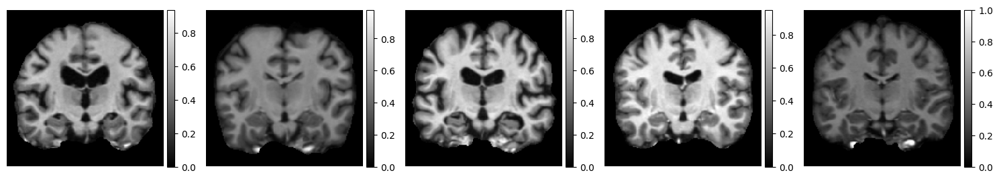

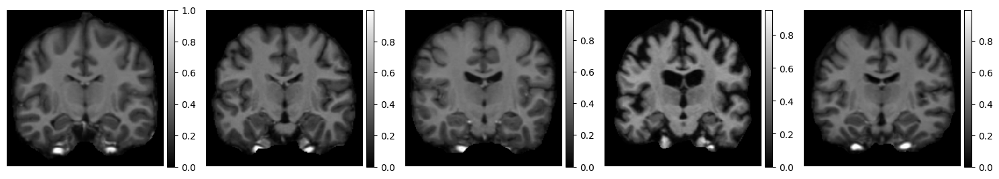

In [10]:
#Loading the dataset
images = ne.py.data.load_dataset('2D-OASIS-TUTORIAL')
conformed_images = [conform(img) for img in images]
#label_maps_real = [(img*15).astype('int').reshape(256, 256) for img in conformed_images]
label_maps_real = [img.reshape(256, 256) for img in conformed_images]


# Visualizing the dataset.
num_row = 2
per_row = 5
for i in range(0, num_row * per_row, per_row):
    ne.plot.slices(label_maps_real[i:i + per_row], cmaps=['gray'], do_colorbars=True)

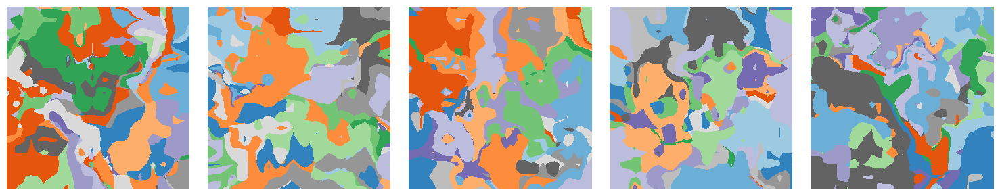

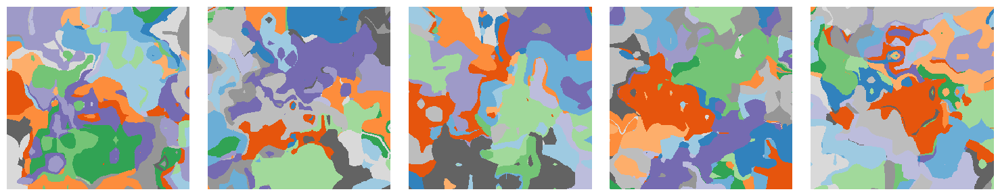

In [11]:
if os.path.exists('Synthetic_data.npy'):
    SynthIm = SynthLabels()
    label_maps_synth = np.load('Synthetic_data.npy')
    SynthIm.label_maps = label_maps_synth
else:
    SynthIm = SynthLabels()
    label_maps_synth = SynthIm.label_maps()
    np.save('Synthetic_data.npy', label_maps_synth)

# Visualize shapes.
num_row = 2
per_row = 5
for i in range(0, num_row * per_row, per_row):
    ne.plot.slices(list(label_maps_synth[i:i + per_row]), cmaps=['tab20c'])

In [12]:
class VxmTest():
    def __init__(self, ndim = 2, unet_input_features = 2):
        self.ndim = ndim
        self.unet_input_features = unet_input_features
    #CNN model
        # configure unet input shape (concatenation of moving and fixed images)
        self.vol_shape = real_train.shape[1:]
        # configure unet features 
        self.nb_features = [
            [32, 32, 32, 32],         # encoder features
            [32, 32, 32, 32, 32, 16]  # decoder features
        ]
        
        
    def CNNvxm(self, train_gen=None, val_generator=None):
        self.vxm_model = vxm.networks.VxmDense(self.vol_shape, nb_unet_features=None, int_steps=0)
        self.losses = ['mse', vxm.losses.Grad('l2').loss]
        self.loss_weights = [1, 0.01]
        self.vxm_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4), loss=self.losses, loss_weights=self.loss_weights)
        

        self.train_generator = train_gen
        self.val_generator = val_generator

        self.in_sample, self.out_sample = next(self.train_generator)
        def Visual():
            # visualize
            images = [img[0, :, :, 0] for img in self.in_sample + self.out_sample]
            titles = ['moving', 'fixed', 'moved ground-truth (fixed)', 'zeros']
            ne.plot.slices(images, titles=titles, cmaps=['gray'], do_colorbars=True);
        Visual()
        
    def train(self, total_epo, steps_per_epoch=100):

        # self.cp_callback = ModelCheckpoint(filepath=path, save_weights_only=False, verbose=1)
        # self.callbacks=[cp_callback]
        self.hist = self.vxm_model.fit(self.train_generator, epochs=total_epo,
                                       steps_per_epoch=100, verbose=verbose,
                                       callbacks=[TqdmCallback(verbose=verbose)],
                                       validation_data=self.val_generator,
                                       validation_steps = 100);
        plot_history(self.hist)
        
    def RegPred(self, val_input):
        self.val_pred = self.vxm_model.predict(val_input)
        #visualise
        def Visual():
            images = [img[0, :, :, 0] for img in val_input + self.val_pred] 
            titles = ['moving', 'fixed', 'moved', 'flow']
            ne.plot.slices(images, titles=titles, cmaps=['gray'], do_colorbars=True);
        Visual()
        return self.val_pred

In [13]:
#Fixing data + spliting

#conversion of labels in range of [0,1]
label_maps_real = np.array(label_maps_real)
label_maps_synth = np.array(label_maps_synth)
#label_maps_real = label_maps_real.astype('float')/15
#label_maps_synth = label_maps_synth.astype('float')/15
#label_maps_hy = np.zeros((250, 256, 256))
#label_maps_hy[::2] = [i for i in label_maps_real[:125, ...]]
#label_maps_hy[1::2] = [i for i in label_maps_synth[:125, ...]]
#label_maps_hy = np.array(label_maps_hy)

#data split 
Data_split_train = 250
real_train = label_maps_real[:250, ...]
# few_shot_train = label_maps_real[:50, ...]
test_val_no = 82
real_val = label_maps_real[250:332, ...]
real_test = label_maps_real[-82:, ...]

In [14]:
# if colab_run:
#     train_no = 100
#     batch_size = 8
# else:
#     train_no = 2000
#     batch_size = 32

In [15]:
train_no = 1000
# no_of_rounds = 2
batch_size = 16
alpha_real = 0.9

In [16]:
# create the few shot data generator
# few_generator = vxm_data_generator_real(real_train, batch_size = 8)
# few_input, _ = next(few_generator)

# create the training data generator
train_generator = vxm_data_generator_real(real_train, batch_size = batch_size)
train_input, _ = next(train_generator)

# create the validation data generator
val_generator = vxm_data_generator_real(real_val, batch_size = batch_size)
val_input, _ = next(val_generator)

# create synthetic data generator
synth_generator = vxm_data_generator_synth(label_maps_synth, SynthIm.label_to_image, batch_size=batch_size)
synth_input, _ = next(synth_generator)

#example of the hybrid data generator
hybrid_generator = vxm_data_generator_hybrid(real_train, label_maps_synth, SynthIm.label_to_image, alpha_real=alpha_real, batch_size=batch_size)
hybrid_input, _ = next(hybrid_generator)

2023-09-22 19:27:01.233961: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:432] Loaded cuDNN version 8600


1/1 - 4s - 4s/epoch - 4s/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 36ms/epoch - 36ms/step


In [17]:
def plot_csv(filename):
    df = pd.read_csv(filename)
    nu = df.to_numpy()
    fh = nu.size
    plt.figure()
    plt.plot(range(1,nu.size+1), nu, '.-')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.show()

In [18]:
#  from tensorflow.keras.callbacks import ModelCheckpoint

1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 142ms/epoch - 142ms/step


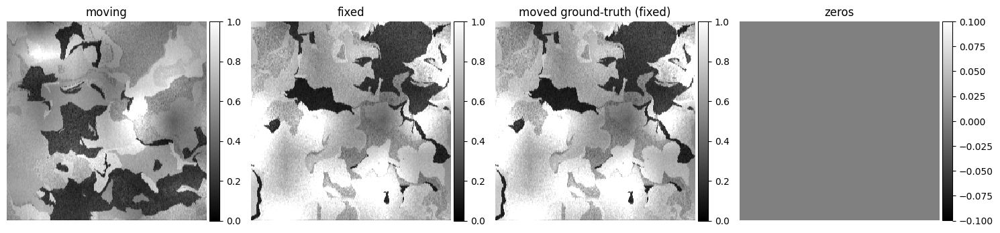

0epoch [00:00, ?epoch/s]

1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 142ms/epoch - 142ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 409ms/epoch - 409ms/step
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 493ms/epoch - 493ms/step


2023-09-22 19:27:09.306354: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7f55bd90d1f0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-09-22 19:27:09.306397: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA RTX A4000, Compute Capability 8.6
2023-09-22 19:27:09.311356: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:255] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2023-09-22 19:27:09.525298: I ./tensorflow/compiler/jit/device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 2/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 3/1000
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 4/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 5/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 6/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 217ms/epoch - 217ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 7/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 8/1000
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 9/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 10/1000
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 184

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 11/1000
1/1 - 0s - 395ms/epoch - 395ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 12/1000
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 13/1000
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 14/1000
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 391ms/epoch - 391ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 15/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 16/1000
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 17/1000
1/1 - 0s - 423ms/epoch - 423ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 181

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 18/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 19/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 393ms/epoch - 393ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 20/1000
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 21/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 22/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 23/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 405ms/epoch - 405ms/step
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 157

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 24/1000
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 25/1000
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 26/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 181

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 27/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 176

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 28/1000
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 186

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 29/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 30/1000
1/1 - 0s - 396ms/epoch - 396ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 31/1000
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 32/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 396ms/epoch - 396ms/step
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 33/1000
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 34/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 397ms/epoch - 397ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 35/1000
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 36/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 37/1000
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 203

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 38/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 39/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 40/1000
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 41/1000
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 183

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 42/1000
1/1 - 0s - 394ms/epoch - 394ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 178

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 43/1000
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 44/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 184

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 45/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 46/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 408ms/epoch - 408ms/step
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 144

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 47/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 48/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 405ms/epoch - 405ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 49/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 50/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 51/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 52/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 53/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 54/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 55/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 56/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 57/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 58/1000
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 180

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 59/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 60/1000
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 61/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 62/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 63/1000
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 64/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 65/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 178

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 66/1000
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 67/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 399ms/epoch - 399ms/step
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 68/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 69/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 70/1000
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 71/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 72/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 73/1000
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 192

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 74/1000
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 75/1000
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 76/1000
1/1 - 0s - 390ms/epoch - 390ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 77/1000
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 78/1000
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 79/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 80/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 171

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 81/1000
1/1 - 0s - 395ms/epoch - 395ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 82/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 83/1000
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 190

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 84/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 85/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 86/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 87/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 190

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 88/1000
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 89/1000
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 171

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 90/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 91/1000
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 92/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 93/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 94/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 95/1000
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 96/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 97/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 397ms/epoch - 397ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 98/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 99/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 395ms/epoch - 395ms/step
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 100/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 101/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 102/1000
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 103/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 104/1000
1/1 - 0s - 399ms/epoch - 399ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 105/1000
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 106/1000
1/1 - 0s - 405ms/epoch - 405ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 107/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 108/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 109/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 391ms/epoch - 391ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 110/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 111/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 112/1000
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 430ms/epoch - 430ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 113/1000
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 114/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 115/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 116/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 390ms/epoch - 390ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 117/1000
1/1 - 0s - 394ms/epoch - 394ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 118/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 119/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 120/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 121/1000
1/1 - 0s - 396ms/epoch - 396ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 122/1000
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 123/1000
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 124/1000
1/1 - 0s - 394ms/epoch - 394ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 125/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 395ms/epoch - 395ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 126/1000
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 127/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 386ms/epoch - 386ms/step
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 128/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 129/1000
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 130/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 131/1000
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 132/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 133/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 134/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 394ms/epoch - 394ms/step
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 135/1000
1/1 - 0s - 386ms/epoch - 386ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 136/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 137/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 138/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 139/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 140/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 141/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 142/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 143/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 144/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 145/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 146/1000
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 147/1000
1/1 - 0s - 399ms/epoch - 399ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 148/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 149/1000
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 150/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 151/1000
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 394ms/epoch - 394ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 152/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 153/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 154/1000
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 155/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 156/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 412ms/epoch - 412ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 157/1000
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 158/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 159/1000
1/1 - 0s - 394ms/epoch - 394ms/step
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 160/1000
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 161/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 162/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 163/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 164/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 165/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 166/1000
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 167/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 168/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 169/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 170/1000
1/1 - 0s - 397ms/epoch - 397ms/step
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 171/1000
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 172/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 173/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 174/1000
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 175/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 397ms/epoch - 397ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 176/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 177/1000
1/1 - 0s - 401ms/epoch - 401ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 178/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 179/1000
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 180/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 181/1000
1/1 - 0s - 390ms/epoch - 390ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 182/1000
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 183/1000
1/1 - 0s - 393ms/epoch - 393ms/step
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 184/1000
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 185/1000
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 186/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 187/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 188/1000
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 189/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 190/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 191/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 192/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 395ms/epoch - 395ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 193/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 194/1000
1/1 - 0s - 398ms/epoch - 398ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 195/1000
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 196/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 197/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 198/1000
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 199/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 200/1000
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 201/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 202/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 203/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 204/1000
1/1 - 0s - 388ms/epoch - 388ms/step
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 205/1000
1/1 - 0s - 398ms/epoch - 398ms/step
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 206/1000
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 207/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 208/1000
1/1 - 0s - 408ms/epoch - 408ms/step
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 209/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 210/1000
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 211/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 212/1000
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 213/1000
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 214/1000
1/1 - 0s - 395ms/epoch - 395ms/step
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 215/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 216/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 217/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 218/1000
1/1 - 0s - 388ms/epoch - 388ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 219/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 220/1000
1/1 - 0s - 395ms/epoch - 395ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 221/1000
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 222/1000
1/1 - 0s - 386ms/epoch - 386ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 223/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 224/1000
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 225/1000
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 226/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 227/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 398ms/epoch - 398ms/step
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 228/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 229/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 230/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 231/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 232/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 233/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 234/1000
1/1 - 0s - 390ms/epoch - 390ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 235/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 236/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 237/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 238/1000
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 239/1000
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 240/1000
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 241/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 242/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 243/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 244/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 245/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 246/1000
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 247/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 248/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 249/1000
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 250/1000
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 251/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 252/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 253/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 254/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 255/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 256/1000
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 257/1000
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 258/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 259/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 260/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 261/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 397ms/epoch - 397ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 262/1000
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 263/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 264/1000
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 386ms/epoch - 386ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 265/1000
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 266/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 267/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 268/1000
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 269/1000
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 265ms/epoch - 265ms/step
Epoch 270/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 271/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 272/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 273/1000
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 274/1000
1/1 - 0s - 390ms/epoch - 390ms/step
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 275/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 276/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 277/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 278/1000
1/1 - 0s - 386ms/epoch - 386ms/step
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 279/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 280/1000
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 281/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 282/1000
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 283/1000
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 284/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 285/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 286/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 287/1000
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 288/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 289/1000
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 290/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 291/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 292/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 293/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 294/1000
1/1 - 0s - 404ms/epoch - 404ms/step
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 295/1000
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 296/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 297/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 298/1000
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 299/1000
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 300/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 301/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 302/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 303/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 304/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 305/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 306/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 307/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 308/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 309/1000
1/1 - 0s - 395ms/epoch - 395ms/step
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 310/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 311/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 312/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 313/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 314/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 315/1000
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 316/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 317/1000
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 318/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 319/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 320/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 321/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 322/1000
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 323/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 324/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 325/1000
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 326/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 327/1000
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 328/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 329/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 330/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 331/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 332/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 333/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 397ms/epoch - 397ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 334/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 391ms/epoch - 391ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 335/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 336/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 337/1000
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 338/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 339/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 340/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 341/1000
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 342/1000
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 343/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 344/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 345/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 346/1000
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 347/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 348/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 349/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 350/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 351/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 352/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 353/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 354/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 355/1000
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 356/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 357/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 358/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 359/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 360/1000
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 361/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 362/1000
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 363/1000
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 364/1000
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 365/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 366/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 367/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 368/1000
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 369/1000
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 370/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 371/1000
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 372/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 391ms/epoch - 391ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 373/1000
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 374/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 393ms/epoch - 393ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 375/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 376/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 377/1000
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 378/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 379/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 380/1000
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 381/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 382/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 383/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 384/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 385/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 386/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 387/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 388/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 389/1000
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 390/1000
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 391/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 392/1000
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 393/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 398ms/epoch - 398ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 394/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 395/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 396/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 406ms/epoch - 406ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 397/1000
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 398/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 399/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 400/1000
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 401/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 402/1000
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 403/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 404/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 405/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 411ms/epoch - 411ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 406/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 407/1000
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 408/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 409/1000
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 410/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 411/1000
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 412/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 413/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 414/1000
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 415/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 416/1000
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 417/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 418/1000
1/1 - 0s - 398ms/epoch - 398ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 419/1000
1/1 - 0s - 396ms/epoch - 396ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 420/1000
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 421/1000
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 422/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 423/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 424/1000
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 425/1000
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 426/1000
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 427/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 428/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 429/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 430/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 431/1000
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 432/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 433/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 434/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 435/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 436/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 437/1000
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 438/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 439/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 440/1000
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 441/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 442/1000
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 443/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 444/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 445/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 446/1000
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 447/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 448/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 449/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 450/1000
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 451/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 452/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 453/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 454/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 455/1000
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 456/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 457/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 458/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 459/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 460/1000
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 461/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 462/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 463/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 464/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 465/1000
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 466/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 467/1000
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 468/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 469/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 470/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 471/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 472/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 473/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 474/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 475/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 476/1000
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 477/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 478/1000
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 479/1000
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 480/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 481/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 482/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 483/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 484/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 485/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 486/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 487/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 488/1000
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 489/1000
1/1 - 0s - 398ms/epoch - 398ms/step
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 490/1000
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 491/1000
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 492/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 493/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 494/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 495/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 496/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 497/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 498/1000
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 499/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 500/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 501/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 502/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 503/1000
1/1 - 0s - 404ms/epoch - 404ms/step
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 504/1000
1/1 - 0s - 386ms/epoch - 386ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 505/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 506/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 507/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 508/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 509/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 510/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 511/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 512/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 386ms/epoch - 386ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 513/1000
1/1 - 0s - 390ms/epoch - 390ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 514/1000
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 515/1000
1/1 - 0s - 393ms/epoch - 393ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 516/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 517/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 391ms/epoch - 391ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 518/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 519/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 520/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 521/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 522/1000
1/1 - 0s - 386ms/epoch - 386ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 523/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 524/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 525/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 526/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 527/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 528/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 529/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 530/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 531/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 532/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 533/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 534/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 535/1000
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 536/1000
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 537/1000
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 538/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 539/1000
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 540/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 541/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 542/1000
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 543/1000
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 544/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 545/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 546/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 547/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 548/1000
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 549/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 386ms/epoch - 386ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 550/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 551/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 552/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 553/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 554/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 555/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 556/1000
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 557/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 558/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 559/1000
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 560/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 561/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 562/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 563/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 564/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 565/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 566/1000
1/1 - 0s - 391ms/epoch - 391ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 567/1000
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 568/1000
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 569/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 570/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 239ms/epoch - 239ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 571/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 572/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 573/1000
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 574/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 575/1000
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 576/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 577/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 578/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 579/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 580/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 581/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 582/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 583/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 584/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 585/1000
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 586/1000
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 587/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 588/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 589/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 590/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 591/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 386ms/epoch - 386ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 592/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 593/1000
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 594/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 395ms/epoch - 395ms/step
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 595/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 596/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 597/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 598/1000
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 599/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 386ms/epoch - 386ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 600/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 394ms/epoch - 394ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 601/1000
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 602/1000
1/1 - 0s - 395ms/epoch - 395ms/step
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 603/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 604/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 605/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 606/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 607/1000
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 608/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 609/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 610/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 611/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 612/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 613/1000
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 614/1000
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 615/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 616/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 617/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 618/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 619/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 620/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 621/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 622/1000
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 623/1000
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 393ms/epoch - 393ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 624/1000
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 625/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 626/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 627/1000
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 628/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 629/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 630/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 631/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 632/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 633/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 634/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 635/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 636/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 637/1000
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 638/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 639/1000
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 640/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 641/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 642/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 643/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 644/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 645/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 646/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 647/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 648/1000
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 649/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 650/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 404ms/epoch - 404ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 651/1000
1/1 - 0s - 396ms/epoch - 396ms/step
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 652/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 393ms/epoch - 393ms/step
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 653/1000
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 654/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 655/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 656/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 399ms/epoch - 399ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 657/1000
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 658/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 659/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 660/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 661/1000
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 662/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 663/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 664/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 665/1000
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 666/1000
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 667/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 668/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 669/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 670/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 671/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 672/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 673/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 674/1000
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 675/1000
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 676/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 677/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 678/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 679/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 680/1000
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 681/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 682/1000
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 683/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 684/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 685/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 686/1000
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 687/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 688/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 689/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 690/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 691/1000
1/1 - 0s - 392ms/epoch - 392ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 692/1000
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 693/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 694/1000
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 695/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 696/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 697/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 698/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 699/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 700/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 701/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 702/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 703/1000
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 704/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 705/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 706/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 707/1000
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 708/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 709/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 710/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 711/1000
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 712/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 713/1000
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 714/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 715/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 716/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 717/1000
1/1 - 0s - 401ms/epoch - 401ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 718/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 719/1000
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 720/1000
1/1 - 0s - 388ms/epoch - 388ms/step
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 721/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 722/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 723/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 724/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 725/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 726/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 727/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 728/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 729/1000
1/1 - 0s - 397ms/epoch - 397ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 730/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 731/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 732/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 733/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 734/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 735/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 736/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 737/1000
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 738/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 739/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 740/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 741/1000
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 742/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 743/1000
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 744/1000
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 745/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 746/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 747/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 748/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 749/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 750/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 751/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 752/1000
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 753/1000
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 754/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 755/1000
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 756/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 757/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 758/1000
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 759/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 760/1000
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 761/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 762/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 763/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 764/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 765/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 766/1000
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 767/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 768/1000
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 769/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 770/1000
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 771/1000
1/1 - 0s - 412ms/epoch - 412ms/step
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 772/1000
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 773/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 774/1000
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 775/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 776/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 777/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 778/1000
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 779/1000
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 780/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 781/1000
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 782/1000
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 783/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 784/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 785/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 786/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 787/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 788/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 789/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 790/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 791/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 792/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 793/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 794/1000
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 795/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 796/1000
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 797/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 385ms/epoch - 385ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 798/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 799/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 800/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 801/1000
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 802/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 803/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 804/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 805/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 806/1000
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 807/1000
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 808/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 809/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 810/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 811/1000
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 812/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 813/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 814/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 815/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 816/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 817/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 818/1000
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 819/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 820/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 821/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 822/1000
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 823/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 824/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 825/1000
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 826/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 827/1000
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 828/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 829/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 830/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 831/1000
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 832/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 833/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 834/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 835/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 836/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 837/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 838/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 839/1000
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 840/1000
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 841/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 842/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 843/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 844/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 845/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 846/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 847/1000
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 848/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 849/1000
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 388ms/epoch - 388ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 850/1000
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 851/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 852/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 853/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 854/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 381ms/epoch - 381ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 855/1000
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 856/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 857/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 858/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 859/1000
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 860/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 861/1000
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 862/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 863/1000
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 864/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 865/1000
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 866/1000
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 867/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 868/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 869/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 870/1000
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 871/1000
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 872/1000
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 873/1000
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 874/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 875/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 876/1000
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 877/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 878/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 879/1000
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 880/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 881/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 882/1000
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 883/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 884/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 885/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 886/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 887/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 888/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 889/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 890/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 891/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 892/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 893/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 894/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 895/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 896/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 897/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 898/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 899/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 900/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 901/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 902/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 903/1000
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 904/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 905/1000
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 906/1000
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 907/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 908/1000
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 909/1000
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 910/1000
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 911/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 912/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 913/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 914/1000
1/1 - 0s - 377ms/epoch - 377ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 915/1000
1/1 - 0s - 360ms/epoch - 360ms/step
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 916/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 399ms/epoch - 399ms/step
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 917/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 918/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 919/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 920/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 921/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 922/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 923/1000
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 924/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 925/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 926/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 927/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 928/1000
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 929/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 930/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 931/1000
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 932/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 933/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 934/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 935/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 936/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 937/1000
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 938/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 939/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 940/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 941/1000
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 942/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 943/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 944/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 945/1000
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 946/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 947/1000
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 948/1000
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 949/1000
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 950/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 951/1000
1/1 - 0s - 386ms/epoch - 386ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 952/1000
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 374ms/epoch - 374ms/step
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 953/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 954/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 955/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 956/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 957/1000
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 958/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 959/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 960/1000
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 371ms/epoch - 371ms/step
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 961/1000
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 962/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 963/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 964/1000
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 965/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 966/1000
1/1 - 0s - 372ms/epoch - 372ms/step
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 967/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 968/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 365ms/epoch - 365ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 969/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 970/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 971/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 972/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 973/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 383ms/epoch - 383ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 974/1000
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 975/1000
1/1 - 0s - 379ms/epoch - 379ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 976/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 977/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 384ms/epoch - 384ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 978/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 380ms/epoch - 380ms/step
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 979/1000
1/1 - 0s - 387ms/epoch - 387ms/step
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 980/1000
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 981/1000
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 370ms/epoch - 370ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 982/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 983/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 984/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 985/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 986/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 987/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 988/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 394ms/epoch - 394ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 989/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 990/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 991/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 992/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 382ms/epoch - 382ms/step
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 993/1000
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 994/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 995/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 996/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 997/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 998/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 999/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1000/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 1

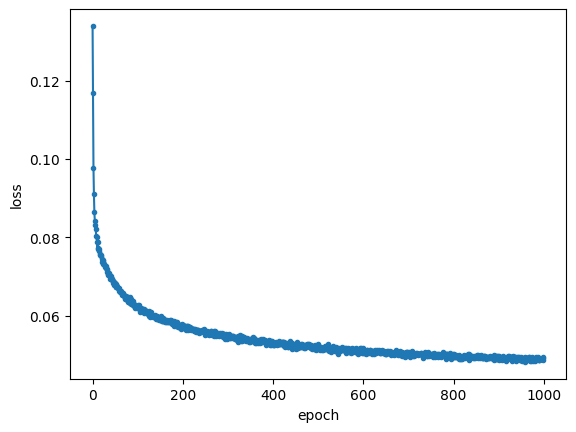

In [19]:
Synth = VxmTest()
Synth.CNNvxm(train_gen=synth_generator, val_generator=val_generator)
Synth.train(total_epo=train_no)
Synth.vxm_model.save_weights(model_loc+'Synth_pure.h5')
b = Synth.hist.history['loss']
a = Synth.hist.history['val_loss']
df = pd.DataFrame(b)
df1= pd.DataFrame(a)
df.to_csv(csv_loc+'Synth_pure_loss.csv', index=False, header=False)
df1.to_csv(csv_loc+'Synth_loss_val.csv', index=False, header=False)
# for i in range(no_of_rounds-1):
#     Synth.vxm_model.load_weights(model_loc+'Synth_pure.h5')
#     Synth.train(total_epo=train_no)
#     Synth.vxm_model.save_weights(model_loc+'Synth_pure.h5')
#     b = Synth.hist.history['loss']
#     df = pd.DataFrame(b)
#     df.to_csv(csv_loc+'Synth_pure_loss.csv', index=False, mode='a', header=False)

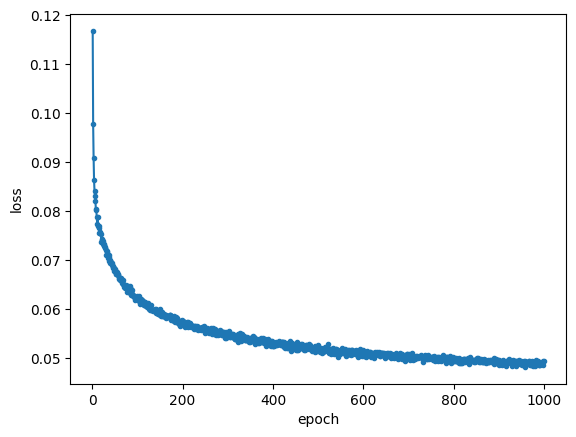

In [20]:
plot_csv(csv_loc + 'Synth_pure_loss.csv')

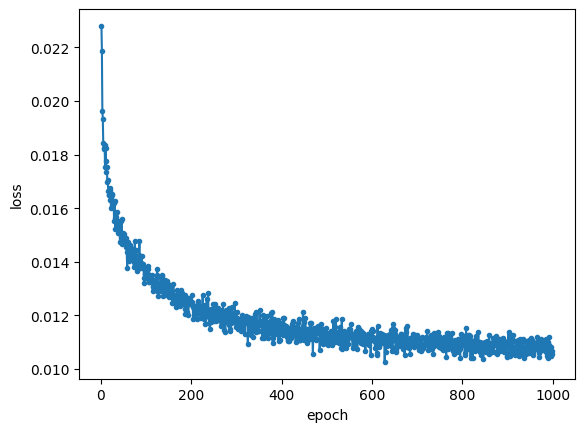

In [21]:
plot_csv(csv_loc+ 'Synth_loss_val.csv')

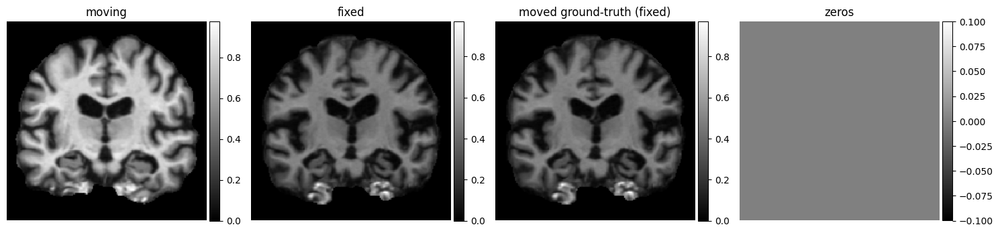

0epoch [00:00, ?epoch/s]

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1/1000
100/100 - 18s - loss: 0.0268 - vxm_dense_transformer_loss: 0.0267 - vxm_dense_flow_loss: 0.0085 - val_loss: 0.0237 - val_vxm_dense_transformer_loss: 0.0231 - val_vxm_dense_flow_loss: 0.0559 - 18s/epoch - 177ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 2/1000
100/100 - 13s - loss: 0.0198 - vxm_dense_transformer_loss: 0.0187 - vxm_dense_flow_loss: 0.1138 - val_loss: 0.0196 - val_vxm_dense_transformer_loss: 0.0181 - val_vxm_dense_flow_loss: 0.1485 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 3/1000
100/100 - 13s - loss: 0.0180 - vxm_dense_transformer_loss: 0.0164 - vxm_dense_flow_loss: 0.1551 - val_loss: 0.0174 - val_vxm_dense_transformer_loss: 0.0157 - val_vxm_dense_flow_loss: 0.1700 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 4/1000
100/100 - 13s - loss: 0.0170 - vxm_dense_transformer_loss: 0.0153 - vxm_dense_flow_loss: 0.1695 - val_loss: 0.0169 - val_vxm_dense_transformer_loss: 0.0151 - val_vxm_dense_flow_loss: 0.1885 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 5/1000
100/100 - 13s - loss: 0.0161 - vxm_dense_transformer_loss: 0.0144 - vxm_dense_flow_loss: 0.1723 - val_loss: 0.0162 - val_vxm_dense_transformer_loss: 0.0144 - val_vxm_dense_flow_loss: 0.1839 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 6/1000
100/100 - 13s - loss: 0.0151 - vxm_dense_transformer_loss: 0.0134 - vxm_dense_flow_loss: 0.1710 - val_loss: 0.0149 - val_vxm_dense_transformer_loss: 0.0131 - val_vxm_dense_flow_loss: 0.1782 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 7/1000
100/100 - 13s - loss: 0.0144 - vxm_dense_transformer_loss: 0.0127 - vxm_dense_flow_loss: 0.1704 - val_loss: 0.0144 - val_vxm_dense_transformer_loss: 0.0125 - val_vxm_dense_flow_loss: 0.1901 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 8/1000
100/100 - 13s - loss: 0.0138 - vxm_dense_transformer_loss: 0.0120 - vxm_dense_flow_loss: 0.1713 - val_loss: 0.0144 - val_vxm_dense_transformer_loss: 0.0125 - val_vxm_dense_flow_loss: 0.1881 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 9/1000
100/100 - 14s - loss: 0.0130 - vxm_dense_transformer_loss: 0.0113 - vxm_dense_flow_loss: 0.1701 - val_loss: 0.0140 - val_vxm_dense_transformer_loss: 0.0121 - val_vxm_dense_flow_loss: 0.1887 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 10/1000
100/100 - 14s - loss: 0.0130 - vxm_dense_transformer_loss: 0.0113 - vxm_dense_flow_loss: 0.1734 - val_loss: 0.0137 - val_vxm_dense_transformer_loss: 0.0118 - val_vxm_dense_flow_loss: 0.1950 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 11/1000
100/100 - 14s - loss: 0.0128 - vxm_dense_transformer_loss: 0.0110 - vxm_dense_flow_loss: 0.1779 - val_loss: 0.0137 - val_vxm_dense_transformer_loss: 0.0119 - val_vxm_dense_flow_loss: 0.1868 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 12/1000
100/100 - 14s - loss: 0.0130 - vxm_dense_transformer_loss: 0.0112 - vxm_dense_flow_loss: 0.1815 - val_loss: 0.0133 - val_vxm_dense_transformer_loss: 0.0113 - val_vxm_dense_flow_loss: 0.1980 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 13/1000
100/100 - 14s - loss: 0.0125 - vxm_dense_transformer_loss: 0.0107 - vxm_dense_flow_loss: 0.1811 - val_loss: 0.0136 - val_vxm_dense_transformer_loss: 0.0115 - val_vxm_dense_flow_loss: 0.2060 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 14/1000
100/100 - 14s - loss: 0.0121 - vxm_dense_transformer_loss: 0.0102 - vxm_dense_flow_loss: 0.1868 - val_loss: 0.0130 - val_vxm_dense_transformer_loss: 0.0111 - val_vxm_dense_flow_loss: 0.1925 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 15/1000
100/100 - 14s - loss: 0.0123 - vxm_dense_transformer_loss: 0.0104 - vxm_dense_flow_loss: 0.1862 - val_loss: 0.0132 - val_vxm_dense_transformer_loss: 0.0112 - val_vxm_dense_flow_loss: 0.2033 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 16/1000
100/100 - 14s - loss: 0.0125 - vxm_dense_transformer_loss: 0.0106 - vxm_dense_flow_loss: 0.1913 - val_loss: 0.0130 - val_vxm_dense_transformer_loss: 0.0111 - val_vxm_dense_flow_loss: 0.1929 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 17/1000
100/100 - 14s - loss: 0.0121 - vxm_dense_transformer_loss: 0.0102 - vxm_dense_flow_loss: 0.1909 - val_loss: 0.0128 - val_vxm_dense_transformer_loss: 0.0107 - val_vxm_dense_flow_loss: 0.2113 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 18/1000
100/100 - 14s - loss: 0.0124 - vxm_dense_transformer_loss: 0.0105 - vxm_dense_flow_loss: 0.1941 - val_loss: 0.0135 - val_vxm_dense_transformer_loss: 0.0115 - val_vxm_dense_flow_loss: 0.2017 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 19/1000
100/100 - 14s - loss: 0.0120 - vxm_dense_transformer_loss: 0.0101 - vxm_dense_flow_loss: 0.1957 - val_loss: 0.0126 - val_vxm_dense_transformer_loss: 0.0104 - val_vxm_dense_flow_loss: 0.2162 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 20/1000
100/100 - 14s - loss: 0.0122 - vxm_dense_transformer_loss: 0.0102 - vxm_dense_flow_loss: 0.1969 - val_loss: 0.0126 - val_vxm_dense_transformer_loss: 0.0106 - val_vxm_dense_flow_loss: 0.2091 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 21/1000
100/100 - 14s - loss: 0.0120 - vxm_dense_transformer_loss: 0.0100 - vxm_dense_flow_loss: 0.1977 - val_loss: 0.0124 - val_vxm_dense_transformer_loss: 0.0105 - val_vxm_dense_flow_loss: 0.1984 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 22/1000
100/100 - 14s - loss: 0.0116 - vxm_dense_transformer_loss: 0.0096 - vxm_dense_flow_loss: 0.1924 - val_loss: 0.0124 - val_vxm_dense_transformer_loss: 0.0104 - val_vxm_dense_flow_loss: 0.2059 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 23/1000
100/100 - 14s - loss: 0.0122 - vxm_dense_transformer_loss: 0.0102 - vxm_dense_flow_loss: 0.1975 - val_loss: 0.0124 - val_vxm_dense_transformer_loss: 0.0103 - val_vxm_dense_flow_loss: 0.2082 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 24/1000
100/100 - 14s - loss: 0.0116 - vxm_dense_transformer_loss: 0.0096 - vxm_dense_flow_loss: 0.1966 - val_loss: 0.0126 - val_vxm_dense_transformer_loss: 0.0105 - val_vxm_dense_flow_loss: 0.2077 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 25/1000
100/100 - 14s - loss: 0.0112 - vxm_dense_transformer_loss: 0.0093 - vxm_dense_flow_loss: 0.1942 - val_loss: 0.0122 - val_vxm_dense_transformer_loss: 0.0101 - val_vxm_dense_flow_loss: 0.2091 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 26/1000
100/100 - 14s - loss: 0.0117 - vxm_dense_transformer_loss: 0.0097 - vxm_dense_flow_loss: 0.1999 - val_loss: 0.0119 - val_vxm_dense_transformer_loss: 0.0098 - val_vxm_dense_flow_loss: 0.2145 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 27/1000
100/100 - 14s - loss: 0.0118 - vxm_dense_transformer_loss: 0.0098 - vxm_dense_flow_loss: 0.2026 - val_loss: 0.0120 - val_vxm_dense_transformer_loss: 0.0099 - val_vxm_dense_flow_loss: 0.2107 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 28/1000
100/100 - 13s - loss: 0.0116 - vxm_dense_transformer_loss: 0.0096 - vxm_dense_flow_loss: 0.2010 - val_loss: 0.0121 - val_vxm_dense_transformer_loss: 0.0099 - val_vxm_dense_flow_loss: 0.2141 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 29/1000
100/100 - 14s - loss: 0.0116 - vxm_dense_transformer_loss: 0.0096 - vxm_dense_flow_loss: 0.2008 - val_loss: 0.0119 - val_vxm_dense_transformer_loss: 0.0099 - val_vxm_dense_flow_loss: 0.2023 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 30/1000
100/100 - 14s - loss: 0.0116 - vxm_dense_transformer_loss: 0.0096 - vxm_dense_flow_loss: 0.2009 - val_loss: 0.0120 - val_vxm_dense_transformer_loss: 0.0099 - val_vxm_dense_flow_loss: 0.2113 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 31/1000
100/100 - 14s - loss: 0.0110 - vxm_dense_transformer_loss: 0.0090 - vxm_dense_flow_loss: 0.1996 - val_loss: 0.0117 - val_vxm_dense_transformer_loss: 0.0096 - val_vxm_dense_flow_loss: 0.2078 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 32/1000
100/100 - 14s - loss: 0.0111 - vxm_dense_transformer_loss: 0.0092 - vxm_dense_flow_loss: 0.1987 - val_loss: 0.0117 - val_vxm_dense_transformer_loss: 0.0096 - val_vxm_dense_flow_loss: 0.2066 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 33/1000
100/100 - 14s - loss: 0.0110 - vxm_dense_transformer_loss: 0.0090 - vxm_dense_flow_loss: 0.1982 - val_loss: 0.0121 - val_vxm_dense_transformer_loss: 0.0100 - val_vxm_dense_flow_loss: 0.2120 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 34/1000
100/100 - 14s - loss: 0.0114 - vxm_dense_transformer_loss: 0.0094 - vxm_dense_flow_loss: 0.2033 - val_loss: 0.0121 - val_vxm_dense_transformer_loss: 0.0101 - val_vxm_dense_flow_loss: 0.2025 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 35/1000
100/100 - 14s - loss: 0.0112 - vxm_dense_transformer_loss: 0.0092 - vxm_dense_flow_loss: 0.1985 - val_loss: 0.0118 - val_vxm_dense_transformer_loss: 0.0098 - val_vxm_dense_flow_loss: 0.2088 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 36/1000
100/100 - 14s - loss: 0.0111 - vxm_dense_transformer_loss: 0.0091 - vxm_dense_flow_loss: 0.1983 - val_loss: 0.0119 - val_vxm_dense_transformer_loss: 0.0099 - val_vxm_dense_flow_loss: 0.1983 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 37/1000
100/100 - 14s - loss: 0.0113 - vxm_dense_transformer_loss: 0.0093 - vxm_dense_flow_loss: 0.2014 - val_loss: 0.0119 - val_vxm_dense_transformer_loss: 0.0097 - val_vxm_dense_flow_loss: 0.2192 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 38/1000
100/100 - 14s - loss: 0.0115 - vxm_dense_transformer_loss: 0.0095 - vxm_dense_flow_loss: 0.1996 - val_loss: 0.0116 - val_vxm_dense_transformer_loss: 0.0095 - val_vxm_dense_flow_loss: 0.2110 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 39/1000
100/100 - 14s - loss: 0.0116 - vxm_dense_transformer_loss: 0.0095 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0118 - val_vxm_dense_transformer_loss: 0.0097 - val_vxm_dense_flow_loss: 0.2077 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 40/1000
100/100 - 14s - loss: 0.0119 - vxm_dense_transformer_loss: 0.0098 - vxm_dense_flow_loss: 0.2002 - val_loss: 0.0118 - val_vxm_dense_transformer_loss: 0.0096 - val_vxm_dense_flow_loss: 0.2243 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 41/1000
100/100 - 14s - loss: 0.0107 - vxm_dense_transformer_loss: 0.0087 - vxm_dense_flow_loss: 0.2011 - val_loss: 0.0115 - val_vxm_dense_transformer_loss: 0.0094 - val_vxm_dense_flow_loss: 0.2172 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 42/1000
100/100 - 14s - loss: 0.0108 - vxm_dense_transformer_loss: 0.0088 - vxm_dense_flow_loss: 0.2006 - val_loss: 0.0115 - val_vxm_dense_transformer_loss: 0.0094 - val_vxm_dense_flow_loss: 0.2096 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 43/1000
100/100 - 14s - loss: 0.0112 - vxm_dense_transformer_loss: 0.0092 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0119 - val_vxm_dense_transformer_loss: 0.0097 - val_vxm_dense_flow_loss: 0.2127 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 44/1000
100/100 - 14s - loss: 0.0111 - vxm_dense_transformer_loss: 0.0090 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0119 - val_vxm_dense_transformer_loss: 0.0098 - val_vxm_dense_flow_loss: 0.2037 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 45/1000
100/100 - 14s - loss: 0.0107 - vxm_dense_transformer_loss: 0.0087 - vxm_dense_flow_loss: 0.1988 - val_loss: 0.0118 - val_vxm_dense_transformer_loss: 0.0096 - val_vxm_dense_flow_loss: 0.2120 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 46/1000
100/100 - 14s - loss: 0.0115 - vxm_dense_transformer_loss: 0.0094 - vxm_dense_flow_loss: 0.2063 - val_loss: 0.0116 - val_vxm_dense_transformer_loss: 0.0094 - val_vxm_dense_flow_loss: 0.2161 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 47/1000
100/100 - 14s - loss: 0.0112 - vxm_dense_transformer_loss: 0.0092 - vxm_dense_flow_loss: 0.2042 - val_loss: 0.0112 - val_vxm_dense_transformer_loss: 0.0091 - val_vxm_dense_flow_loss: 0.2073 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 48/1000
100/100 - 14s - loss: 0.0106 - vxm_dense_transformer_loss: 0.0086 - vxm_dense_flow_loss: 0.2029 - val_loss: 0.0114 - val_vxm_dense_transformer_loss: 0.0092 - val_vxm_dense_flow_loss: 0.2139 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 49/1000
100/100 - 14s - loss: 0.0107 - vxm_dense_transformer_loss: 0.0087 - vxm_dense_flow_loss: 0.1991 - val_loss: 0.0117 - val_vxm_dense_transformer_loss: 0.0095 - val_vxm_dense_flow_loss: 0.2194 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 50/1000
100/100 - 14s - loss: 0.0108 - vxm_dense_transformer_loss: 0.0088 - vxm_dense_flow_loss: 0.2004 - val_loss: 0.0113 - val_vxm_dense_transformer_loss: 0.0092 - val_vxm_dense_flow_loss: 0.2060 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 51/1000
100/100 - 14s - loss: 0.0110 - vxm_dense_transformer_loss: 0.0089 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0115 - val_vxm_dense_transformer_loss: 0.0092 - val_vxm_dense_flow_loss: 0.2260 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 52/1000
100/100 - 14s - loss: 0.0107 - vxm_dense_transformer_loss: 0.0087 - vxm_dense_flow_loss: 0.2009 - val_loss: 0.0113 - val_vxm_dense_transformer_loss: 0.0093 - val_vxm_dense_flow_loss: 0.2020 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 53/1000
100/100 - 14s - loss: 0.0110 - vxm_dense_transformer_loss: 0.0089 - vxm_dense_flow_loss: 0.2011 - val_loss: 0.0115 - val_vxm_dense_transformer_loss: 0.0094 - val_vxm_dense_flow_loss: 0.2138 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 54/1000
100/100 - 14s - loss: 0.0106 - vxm_dense_transformer_loss: 0.0085 - vxm_dense_flow_loss: 0.2058 - val_loss: 0.0115 - val_vxm_dense_transformer_loss: 0.0094 - val_vxm_dense_flow_loss: 0.2103 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 55/1000
100/100 - 14s - loss: 0.0104 - vxm_dense_transformer_loss: 0.0083 - vxm_dense_flow_loss: 0.2035 - val_loss: 0.0117 - val_vxm_dense_transformer_loss: 0.0095 - val_vxm_dense_flow_loss: 0.2134 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 56/1000
100/100 - 14s - loss: 0.0110 - vxm_dense_transformer_loss: 0.0089 - vxm_dense_flow_loss: 0.2046 - val_loss: 0.0114 - val_vxm_dense_transformer_loss: 0.0093 - val_vxm_dense_flow_loss: 0.2098 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 57/1000
100/100 - 14s - loss: 0.0108 - vxm_dense_transformer_loss: 0.0088 - vxm_dense_flow_loss: 0.2063 - val_loss: 0.0114 - val_vxm_dense_transformer_loss: 0.0092 - val_vxm_dense_flow_loss: 0.2239 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 58/1000
100/100 - 14s - loss: 0.0103 - vxm_dense_transformer_loss: 0.0082 - vxm_dense_flow_loss: 0.2045 - val_loss: 0.0115 - val_vxm_dense_transformer_loss: 0.0093 - val_vxm_dense_flow_loss: 0.2170 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 59/1000
100/100 - 14s - loss: 0.0105 - vxm_dense_transformer_loss: 0.0084 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0114 - val_vxm_dense_transformer_loss: 0.0093 - val_vxm_dense_flow_loss: 0.2120 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 60/1000
100/100 - 13s - loss: 0.0104 - vxm_dense_transformer_loss: 0.0083 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0110 - val_vxm_dense_transformer_loss: 0.0089 - val_vxm_dense_flow_loss: 0.2050 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 61/1000
100/100 - 14s - loss: 0.0104 - vxm_dense_transformer_loss: 0.0084 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0112 - val_vxm_dense_transformer_loss: 0.0091 - val_vxm_dense_flow_loss: 0.2143 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 62/1000
100/100 - 14s - loss: 0.0104 - vxm_dense_transformer_loss: 0.0084 - vxm_dense_flow_loss: 0.2029 - val_loss: 0.0115 - val_vxm_dense_transformer_loss: 0.0093 - val_vxm_dense_flow_loss: 0.2133 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 63/1000
100/100 - 14s - loss: 0.0111 - vxm_dense_transformer_loss: 0.0090 - vxm_dense_flow_loss: 0.2105 - val_loss: 0.0112 - val_vxm_dense_transformer_loss: 0.0090 - val_vxm_dense_flow_loss: 0.2119 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 64/1000
100/100 - 14s - loss: 0.0104 - vxm_dense_transformer_loss: 0.0084 - vxm_dense_flow_loss: 0.2054 - val_loss: 0.0112 - val_vxm_dense_transformer_loss: 0.0091 - val_vxm_dense_flow_loss: 0.2108 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 65/1000
100/100 - 14s - loss: 0.0103 - vxm_dense_transformer_loss: 0.0082 - vxm_dense_flow_loss: 0.2049 - val_loss: 0.0116 - val_vxm_dense_transformer_loss: 0.0094 - val_vxm_dense_flow_loss: 0.2228 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 66/1000
100/100 - 14s - loss: 0.0105 - vxm_dense_transformer_loss: 0.0084 - vxm_dense_flow_loss: 0.2042 - val_loss: 0.0111 - val_vxm_dense_transformer_loss: 0.0089 - val_vxm_dense_flow_loss: 0.2173 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 67/1000
100/100 - 14s - loss: 0.0109 - vxm_dense_transformer_loss: 0.0088 - vxm_dense_flow_loss: 0.2026 - val_loss: 0.0116 - val_vxm_dense_transformer_loss: 0.0095 - val_vxm_dense_flow_loss: 0.2094 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 68/1000
100/100 - 14s - loss: 0.0103 - vxm_dense_transformer_loss: 0.0083 - vxm_dense_flow_loss: 0.2009 - val_loss: 0.0106 - val_vxm_dense_transformer_loss: 0.0084 - val_vxm_dense_flow_loss: 0.2145 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 69/1000
100/100 - 14s - loss: 0.0106 - vxm_dense_transformer_loss: 0.0086 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0111 - val_vxm_dense_transformer_loss: 0.0089 - val_vxm_dense_flow_loss: 0.2115 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 70/1000
100/100 - 14s - loss: 0.0104 - vxm_dense_transformer_loss: 0.0084 - vxm_dense_flow_loss: 0.2023 - val_loss: 0.0107 - val_vxm_dense_transformer_loss: 0.0087 - val_vxm_dense_flow_loss: 0.2044 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 71/1000
100/100 - 14s - loss: 0.0106 - vxm_dense_transformer_loss: 0.0085 - vxm_dense_flow_loss: 0.2074 - val_loss: 0.0110 - val_vxm_dense_transformer_loss: 0.0089 - val_vxm_dense_flow_loss: 0.2116 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 72/1000
100/100 - 14s - loss: 0.0104 - vxm_dense_transformer_loss: 0.0083 - vxm_dense_flow_loss: 0.2040 - val_loss: 0.0108 - val_vxm_dense_transformer_loss: 0.0087 - val_vxm_dense_flow_loss: 0.2080 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 73/1000
100/100 - 14s - loss: 0.0105 - vxm_dense_transformer_loss: 0.0084 - vxm_dense_flow_loss: 0.2046 - val_loss: 0.0110 - val_vxm_dense_transformer_loss: 0.0089 - val_vxm_dense_flow_loss: 0.2189 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 74/1000
100/100 - 14s - loss: 0.0105 - vxm_dense_transformer_loss: 0.0085 - vxm_dense_flow_loss: 0.2067 - val_loss: 0.0110 - val_vxm_dense_transformer_loss: 0.0089 - val_vxm_dense_flow_loss: 0.2089 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 75/1000
100/100 - 14s - loss: 0.0100 - vxm_dense_transformer_loss: 0.0080 - vxm_dense_flow_loss: 0.2036 - val_loss: 0.0111 - val_vxm_dense_transformer_loss: 0.0090 - val_vxm_dense_flow_loss: 0.2181 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 76/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0080 - vxm_dense_flow_loss: 0.1992 - val_loss: 0.0110 - val_vxm_dense_transformer_loss: 0.0089 - val_vxm_dense_flow_loss: 0.2104 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 77/1000
100/100 - 14s - loss: 0.0103 - vxm_dense_transformer_loss: 0.0082 - vxm_dense_flow_loss: 0.2023 - val_loss: 0.0111 - val_vxm_dense_transformer_loss: 0.0090 - val_vxm_dense_flow_loss: 0.2079 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 78/1000
100/100 - 14s - loss: 0.0102 - vxm_dense_transformer_loss: 0.0082 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0109 - val_vxm_dense_transformer_loss: 0.0088 - val_vxm_dense_flow_loss: 0.2148 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 79/1000
100/100 - 14s - loss: 0.0104 - vxm_dense_transformer_loss: 0.0084 - vxm_dense_flow_loss: 0.2036 - val_loss: 0.0107 - val_vxm_dense_transformer_loss: 0.0085 - val_vxm_dense_flow_loss: 0.2202 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 80/1000
100/100 - 14s - loss: 0.0104 - vxm_dense_transformer_loss: 0.0083 - vxm_dense_flow_loss: 0.2092 - val_loss: 0.0112 - val_vxm_dense_transformer_loss: 0.0091 - val_vxm_dense_flow_loss: 0.2142 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 81/1000
100/100 - 14s - loss: 0.0104 - vxm_dense_transformer_loss: 0.0083 - vxm_dense_flow_loss: 0.2057 - val_loss: 0.0107 - val_vxm_dense_transformer_loss: 0.0086 - val_vxm_dense_flow_loss: 0.2139 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 82/1000
100/100 - 14s - loss: 0.0102 - vxm_dense_transformer_loss: 0.0081 - vxm_dense_flow_loss: 0.2027 - val_loss: 0.0112 - val_vxm_dense_transformer_loss: 0.0091 - val_vxm_dense_flow_loss: 0.2125 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 83/1000
100/100 - 14s - loss: 0.0098 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0108 - val_vxm_dense_transformer_loss: 0.0088 - val_vxm_dense_flow_loss: 0.2045 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 84/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2054 - val_loss: 0.0107 - val_vxm_dense_transformer_loss: 0.0086 - val_vxm_dense_flow_loss: 0.2085 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 85/1000
100/100 - 14s - loss: 0.0102 - vxm_dense_transformer_loss: 0.0082 - vxm_dense_flow_loss: 0.2061 - val_loss: 0.0106 - val_vxm_dense_transformer_loss: 0.0084 - val_vxm_dense_flow_loss: 0.2163 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 86/1000
100/100 - 14s - loss: 0.0105 - vxm_dense_transformer_loss: 0.0084 - vxm_dense_flow_loss: 0.2029 - val_loss: 0.0108 - val_vxm_dense_transformer_loss: 0.0087 - val_vxm_dense_flow_loss: 0.2157 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 87/1000
100/100 - 14s - loss: 0.0102 - vxm_dense_transformer_loss: 0.0081 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0105 - val_vxm_dense_transformer_loss: 0.0085 - val_vxm_dense_flow_loss: 0.2091 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 88/1000
100/100 - 14s - loss: 0.0101 - vxm_dense_transformer_loss: 0.0080 - vxm_dense_flow_loss: 0.2019 - val_loss: 0.0107 - val_vxm_dense_transformer_loss: 0.0084 - val_vxm_dense_flow_loss: 0.2215 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 89/1000
100/100 - 14s - loss: 0.0101 - vxm_dense_transformer_loss: 0.0081 - vxm_dense_flow_loss: 0.2015 - val_loss: 0.0108 - val_vxm_dense_transformer_loss: 0.0086 - val_vxm_dense_flow_loss: 0.2127 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 90/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2017 - val_loss: 0.0109 - val_vxm_dense_transformer_loss: 0.0088 - val_vxm_dense_flow_loss: 0.2174 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 91/1000
100/100 - 14s - loss: 0.0104 - vxm_dense_transformer_loss: 0.0083 - vxm_dense_flow_loss: 0.2080 - val_loss: 0.0104 - val_vxm_dense_transformer_loss: 0.0083 - val_vxm_dense_flow_loss: 0.2127 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 92/1000
100/100 - 14s - loss: 0.0101 - vxm_dense_transformer_loss: 0.0081 - vxm_dense_flow_loss: 0.2045 - val_loss: 0.0107 - val_vxm_dense_transformer_loss: 0.0086 - val_vxm_dense_flow_loss: 0.2129 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 93/1000
100/100 - 14s - loss: 0.0098 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2050 - val_loss: 0.0108 - val_vxm_dense_transformer_loss: 0.0086 - val_vxm_dense_flow_loss: 0.2148 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 94/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2138 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 95/1000
100/100 - 14s - loss: 0.0100 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2034 - val_loss: 0.0108 - val_vxm_dense_transformer_loss: 0.0086 - val_vxm_dense_flow_loss: 0.2222 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 96/1000
100/100 - 14s - loss: 0.0100 - vxm_dense_transformer_loss: 0.0080 - vxm_dense_flow_loss: 0.2058 - val_loss: 0.0106 - val_vxm_dense_transformer_loss: 0.0084 - val_vxm_dense_flow_loss: 0.2187 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 97/1000
100/100 - 14s - loss: 0.0100 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2061 - val_loss: 0.0106 - val_vxm_dense_transformer_loss: 0.0085 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 98/1000
100/100 - 14s - loss: 0.0100 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2076 - val_loss: 0.0103 - val_vxm_dense_transformer_loss: 0.0082 - val_vxm_dense_flow_loss: 0.2084 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 99/1000
100/100 - 14s - loss: 0.0103 - vxm_dense_transformer_loss: 0.0082 - vxm_dense_flow_loss: 0.2063 - val_loss: 0.0107 - val_vxm_dense_transformer_loss: 0.0085 - val_vxm_dense_flow_loss: 0.2170 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 100/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2053 - val_loss: 0.0105 - val_vxm_dense_transformer_loss: 0.0084 - val_vxm_dense_flow_loss: 0.2107 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 101/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2053 - val_loss: 0.0106 - val_vxm_dense_transformer_loss: 0.0084 - val_vxm_dense_flow_loss: 0.2173 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 102/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2040 - val_loss: 0.0106 - val_vxm_dense_transformer_loss: 0.0085 - val_vxm_dense_flow_loss: 0.2127 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 103/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2050 - val_loss: 0.0107 - val_vxm_dense_transformer_loss: 0.0086 - val_vxm_dense_flow_loss: 0.2063 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 104/1000
100/100 - 14s - loss: 0.0098 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2057 - val_loss: 0.0105 - val_vxm_dense_transformer_loss: 0.0084 - val_vxm_dense_flow_loss: 0.2115 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 105/1000
100/100 - 14s - loss: 0.0101 - vxm_dense_transformer_loss: 0.0080 - vxm_dense_flow_loss: 0.2068 - val_loss: 0.0105 - val_vxm_dense_transformer_loss: 0.0084 - val_vxm_dense_flow_loss: 0.2160 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 106/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2073 - val_loss: 0.0107 - val_vxm_dense_transformer_loss: 0.0085 - val_vxm_dense_flow_loss: 0.2145 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 107/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0107 - val_vxm_dense_transformer_loss: 0.0085 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 108/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2117 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 109/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0103 - val_vxm_dense_transformer_loss: 0.0082 - val_vxm_dense_flow_loss: 0.2050 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 110/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0106 - val_vxm_dense_transformer_loss: 0.0084 - val_vxm_dense_flow_loss: 0.2163 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 111/1000
100/100 - 14s - loss: 0.0098 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2056 - val_loss: 0.0106 - val_vxm_dense_transformer_loss: 0.0084 - val_vxm_dense_flow_loss: 0.2224 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 112/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2015 - val_loss: 0.0104 - val_vxm_dense_transformer_loss: 0.0083 - val_vxm_dense_flow_loss: 0.2081 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 113/1000
100/100 - 14s - loss: 0.0102 - vxm_dense_transformer_loss: 0.0081 - vxm_dense_flow_loss: 0.2054 - val_loss: 0.0109 - val_vxm_dense_transformer_loss: 0.0088 - val_vxm_dense_flow_loss: 0.2140 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 114/1000
100/100 - 14s - loss: 0.0098 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2020 - val_loss: 0.0104 - val_vxm_dense_transformer_loss: 0.0083 - val_vxm_dense_flow_loss: 0.2137 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 115/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0077 - vxm_dense_flow_loss: 0.2041 - val_loss: 0.0104 - val_vxm_dense_transformer_loss: 0.0083 - val_vxm_dense_flow_loss: 0.2076 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 116/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2073 - val_loss: 0.0109 - val_vxm_dense_transformer_loss: 0.0087 - val_vxm_dense_flow_loss: 0.2215 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 117/1000
100/100 - 14s - loss: 0.0101 - vxm_dense_transformer_loss: 0.0080 - vxm_dense_flow_loss: 0.2101 - val_loss: 0.0103 - val_vxm_dense_transformer_loss: 0.0082 - val_vxm_dense_flow_loss: 0.2119 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 118/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2006 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2028 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 119/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2064 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2090 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 120/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0077 - vxm_dense_flow_loss: 0.2075 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 121/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2054 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2137 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 122/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0077 - vxm_dense_flow_loss: 0.2033 - val_loss: 0.0105 - val_vxm_dense_transformer_loss: 0.0084 - val_vxm_dense_flow_loss: 0.2062 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 123/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2033 - val_loss: 0.0108 - val_vxm_dense_transformer_loss: 0.0086 - val_vxm_dense_flow_loss: 0.2184 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 124/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2012 - val_loss: 0.0105 - val_vxm_dense_transformer_loss: 0.0083 - val_vxm_dense_flow_loss: 0.2114 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 125/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2098 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 126/1000
100/100 - 14s - loss: 0.0098 - vxm_dense_transformer_loss: 0.0077 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0102 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2097 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 127/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2053 - val_loss: 0.0108 - val_vxm_dense_transformer_loss: 0.0086 - val_vxm_dense_flow_loss: 0.2123 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 128/1000
100/100 - 14s - loss: 0.0101 - vxm_dense_transformer_loss: 0.0080 - vxm_dense_flow_loss: 0.2057 - val_loss: 0.0102 - val_vxm_dense_transformer_loss: 0.0082 - val_vxm_dense_flow_loss: 0.2035 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 129/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2015 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2142 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 130/1000
100/100 - 14s - loss: 0.0098 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2076 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2161 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 131/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2064 - val_loss: 0.0104 - val_vxm_dense_transformer_loss: 0.0083 - val_vxm_dense_flow_loss: 0.2147 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 132/1000
100/100 - 14s - loss: 0.0100 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2084 - val_loss: 0.0105 - val_vxm_dense_transformer_loss: 0.0083 - val_vxm_dense_flow_loss: 0.2207 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 133/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2020 - val_loss: 0.0104 - val_vxm_dense_transformer_loss: 0.0082 - val_vxm_dense_flow_loss: 0.2128 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 134/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0103 - val_vxm_dense_transformer_loss: 0.0082 - val_vxm_dense_flow_loss: 0.2143 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 135/1000
100/100 - 14s - loss: 0.0104 - vxm_dense_transformer_loss: 0.0083 - vxm_dense_flow_loss: 0.2080 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2009 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 136/1000
100/100 - 14s - loss: 0.0100 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2092 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 137/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2045 - val_loss: 0.0102 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2087 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 138/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0104 - val_vxm_dense_transformer_loss: 0.0082 - val_vxm_dense_flow_loss: 0.2158 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 139/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2017 - val_loss: 0.0105 - val_vxm_dense_transformer_loss: 0.0083 - val_vxm_dense_flow_loss: 0.2176 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 140/1000
100/100 - 14s - loss: 0.0098 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0102 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2161 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 141/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2058 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2060 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 142/1000
100/100 - 14s - loss: 0.0102 - vxm_dense_transformer_loss: 0.0081 - vxm_dense_flow_loss: 0.2112 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2138 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 143/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2034 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2171 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 144/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.1987 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 145/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2198 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 146/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2083 - val_loss: 0.0105 - val_vxm_dense_transformer_loss: 0.0083 - val_vxm_dense_flow_loss: 0.2222 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 147/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0077 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0105 - val_vxm_dense_transformer_loss: 0.0084 - val_vxm_dense_flow_loss: 0.2076 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 148/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2089 - val_loss: 0.0107 - val_vxm_dense_transformer_loss: 0.0085 - val_vxm_dense_flow_loss: 0.2200 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 149/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2114 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2162 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 150/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2037 - val_loss: 0.0104 - val_vxm_dense_transformer_loss: 0.0082 - val_vxm_dense_flow_loss: 0.2176 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 151/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2046 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2148 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 152/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2073 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 153/1000
100/100 - 14s - loss: 0.0100 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2143 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2062 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 154/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2068 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2078 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 155/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2097 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2140 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 156/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2125 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2140 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 157/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2077 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2192 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 158/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2037 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2075 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 159/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2103 - val_loss: 0.0105 - val_vxm_dense_transformer_loss: 0.0084 - val_vxm_dense_flow_loss: 0.2096 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 160/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2081 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 161/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2077 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2091 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 162/1000
100/100 - 14s - loss: 0.0100 - vxm_dense_transformer_loss: 0.0079 - vxm_dense_flow_loss: 0.2107 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2174 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 163/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2058 - val_loss: 0.0104 - val_vxm_dense_transformer_loss: 0.0084 - val_vxm_dense_flow_loss: 0.2053 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 164/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0102 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2130 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 165/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2035 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2072 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 166/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2033 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2144 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 167/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0104 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2224 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 168/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2024 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2114 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 169/1000
100/100 - 14s - loss: 0.0098 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2208 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 170/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2037 - val_loss: 0.0105 - val_vxm_dense_transformer_loss: 0.0083 - val_vxm_dense_flow_loss: 0.2198 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 171/1000
100/100 - 14s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2092 - val_loss: 0.0104 - val_vxm_dense_transformer_loss: 0.0082 - val_vxm_dense_flow_loss: 0.2162 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 172/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2072 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2177 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 173/1000
100/100 - 14s - loss: 0.0098 - vxm_dense_transformer_loss: 0.0077 - vxm_dense_flow_loss: 0.2065 - val_loss: 0.0102 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2164 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 174/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2082 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2129 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 175/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2037 - val_loss: 0.0102 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2132 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 176/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2079 - val_loss: 0.0103 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2165 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 177/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2076 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2117 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 178/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2040 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2179 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 179/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0077 - vxm_dense_flow_loss: 0.2077 - val_loss: 0.0102 - val_vxm_dense_transformer_loss: 0.0082 - val_vxm_dense_flow_loss: 0.1985 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 180/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2014 - val_loss: 0.0103 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2202 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 181/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2080 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2085 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 182/1000
100/100 - 14s - loss: 0.0098 - vxm_dense_transformer_loss: 0.0077 - vxm_dense_flow_loss: 0.2086 - val_loss: 0.0105 - val_vxm_dense_transformer_loss: 0.0082 - val_vxm_dense_flow_loss: 0.2257 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 183/1000
100/100 - 13s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2050 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2122 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 184/1000
100/100 - 13s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2069 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2154 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 185/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2042 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2122 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 186/1000
100/100 - 13s - loss: 0.0099 - vxm_dense_transformer_loss: 0.0078 - vxm_dense_flow_loss: 0.2072 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2170 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 187/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2068 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2094 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 188/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2073 - val_loss: 0.0104 - val_vxm_dense_transformer_loss: 0.0082 - val_vxm_dense_flow_loss: 0.2180 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 189/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2088 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2123 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 190/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2094 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 191/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2042 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2134 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 192/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2086 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2069 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 193/1000
100/100 - 13s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2025 - val_loss: 0.0103 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2176 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 194/1000
100/100 - 13s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0077 - vxm_dense_flow_loss: 0.2073 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2040 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 195/1000
100/100 - 13s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2045 - val_loss: 0.0102 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2163 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 196/1000
100/100 - 13s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2077 - val_loss: 0.0102 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2153 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 197/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2117 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 198/1000
100/100 - 13s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2120 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 199/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2090 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2101 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 200/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2016 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2129 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 201/1000
100/100 - 13s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2012 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2225 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 202/1000
100/100 - 13s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2145 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 203/1000
100/100 - 13s - loss: 0.0098 - vxm_dense_transformer_loss: 0.0077 - vxm_dense_flow_loss: 0.2098 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2108 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 204/1000
100/100 - 13s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2022 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2152 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 205/1000
100/100 - 13s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2064 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2125 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 206/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2075 - val_loss: 0.0104 - val_vxm_dense_transformer_loss: 0.0083 - val_vxm_dense_flow_loss: 0.2048 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 207/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2005 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2142 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 208/1000
100/100 - 13s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2006 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2176 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 209/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2130 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 210/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2074 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2085 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 211/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2046 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2147 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 212/1000
100/100 - 14s - loss: 0.0098 - vxm_dense_transformer_loss: 0.0077 - vxm_dense_flow_loss: 0.2098 - val_loss: 0.0103 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2171 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 213/1000
100/100 - 13s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2080 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2179 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 214/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2074 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2141 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 215/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2085 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2157 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 216/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2099 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2182 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 217/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2079 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2132 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 218/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2049 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2106 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 219/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2034 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2089 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 220/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2065 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2112 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 221/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2129 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 222/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2040 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2108 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 223/1000
100/100 - 13s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2014 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2147 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 224/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2179 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 225/1000
100/100 - 13s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2020 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2142 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 226/1000
100/100 - 13s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2078 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2153 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 227/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2034 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2177 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 228/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2088 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2172 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 229/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2069 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2154 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 230/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2176 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 231/1000
100/100 - 14s - loss: 0.0098 - vxm_dense_transformer_loss: 0.0077 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2194 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 232/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2041 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2091 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 233/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2008 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2189 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 234/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2037 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2161 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 235/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2108 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2088 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 236/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0102 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2217 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 237/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2052 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2107 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 238/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2069 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2170 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 239/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2053 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2123 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 240/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2118 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 241/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2087 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 242/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2049 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2171 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 243/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2074 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2200 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 244/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2157 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 245/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2052 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 246/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2102 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2156 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 247/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2081 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2072 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 248/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2045 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2227 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 249/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2115 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 250/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2018 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2134 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 251/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2078 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2127 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 252/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2005 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2230 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 253/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2209 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 254/1000
100/100 - 13s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2045 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2143 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 255/1000
100/100 - 13s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2093 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2161 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 256/1000
100/100 - 13s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2045 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2112 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 257/1000
100/100 - 13s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2069 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2163 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 258/1000
100/100 - 13s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2051 - val_loss: 0.0104 - val_vxm_dense_transformer_loss: 0.0081 - val_vxm_dense_flow_loss: 0.2212 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 259/1000
100/100 - 13s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2087 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2106 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 260/1000
100/100 - 13s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2019 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2214 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 261/1000
100/100 - 13s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2191 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 262/1000
100/100 - 13s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2133 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0080 - val_vxm_dense_flow_loss: 0.2102 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 263/1000
100/100 - 13s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2102 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2194 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 264/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2017 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2109 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 265/1000
100/100 - 13s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2091 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2146 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 266/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2086 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2167 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 267/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2137 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2195 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 268/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2064 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2057 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 269/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 270/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2021 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2133 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 271/1000
100/100 - 13s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2132 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2131 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 272/1000
100/100 - 13s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2021 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2107 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 273/1000
100/100 - 13s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2100 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2199 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 274/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2193 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 275/1000
100/100 - 13s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2126 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2090 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 276/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2110 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2096 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 277/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2023 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2027 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 278/1000
100/100 - 14s - loss: 0.0096 - vxm_dense_transformer_loss: 0.0075 - vxm_dense_flow_loss: 0.2080 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2077 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 279/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2036 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2114 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 280/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2017 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2104 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 281/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2054 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2175 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 282/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2075 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2149 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 283/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2078 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2169 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 284/1000
100/100 - 14s - loss: 0.0097 - vxm_dense_transformer_loss: 0.0076 - vxm_dense_flow_loss: 0.2050 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2174 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 285/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2021 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2120 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 286/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2032 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2183 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 287/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2017 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2083 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 288/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2078 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 289/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2032 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2129 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 290/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2094 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2236 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 291/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2023 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2037 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 292/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2046 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 293/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2091 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2180 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 294/1000
100/100 - 13s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2008 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2163 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 295/1000
100/100 - 13s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2087 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2153 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 296/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2074 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2193 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 297/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2068 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2162 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 298/1000
100/100 - 13s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2102 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2155 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 299/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2037 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2119 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 300/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2063 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2134 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 301/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2071 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2126 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 302/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2069 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 303/1000
100/100 - 13s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2140 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 304/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2036 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2122 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 305/1000
100/100 - 13s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2087 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2199 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 306/1000
100/100 - 13s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2110 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 307/1000
100/100 - 13s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2103 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2117 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 308/1000
100/100 - 13s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2046 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2136 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 309/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2035 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2179 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 310/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2071 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2154 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 311/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2079 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2152 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 312/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2076 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2169 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 313/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2096 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2151 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 314/1000
100/100 - 14s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2077 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2229 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 315/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2097 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2170 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 316/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2093 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2190 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 317/1000
100/100 - 13s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2041 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2101 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 318/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2056 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2165 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 319/1000
100/100 - 13s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2020 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2153 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 320/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2170 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 321/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2078 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2162 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 322/1000
100/100 - 13s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2015 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2163 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 323/1000
100/100 - 13s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2102 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2137 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 324/1000
100/100 - 13s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2068 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2158 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 325/1000
100/100 - 13s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2192 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 326/1000
100/100 - 13s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2119 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 327/1000
100/100 - 13s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2031 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2144 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 328/1000
100/100 - 13s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2057 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2204 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 329/1000
100/100 - 13s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2116 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 330/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2076 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2149 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 331/1000
100/100 - 13s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2042 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2120 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 332/1000
100/100 - 13s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2122 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2199 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 333/1000
100/100 - 13s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2075 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2086 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 334/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2082 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2078 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 335/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2064 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2129 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 336/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2094 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2165 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 337/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2134 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2200 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 338/1000
100/100 - 13s - loss: 0.0095 - vxm_dense_transformer_loss: 0.0074 - vxm_dense_flow_loss: 0.2101 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2075 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 339/1000
100/100 - 13s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2069 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2136 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 340/1000
100/100 - 13s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2129 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 341/1000
100/100 - 13s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2098 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2164 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 342/1000
100/100 - 13s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2007 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2112 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 343/1000
100/100 - 13s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2147 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2100 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 344/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2058 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2179 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 345/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2096 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2121 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 346/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2079 - val_loss: 0.0101 - val_vxm_dense_transformer_loss: 0.0079 - val_vxm_dense_flow_loss: 0.2189 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 347/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2029 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2173 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 348/1000
100/100 - 13s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2114 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2153 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 349/1000
100/100 - 13s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2027 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2141 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 350/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2042 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2128 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 351/1000
100/100 - 13s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2108 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2146 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 352/1000
100/100 - 13s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2067 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2184 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 353/1000
100/100 - 13s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2090 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 354/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2087 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2231 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 355/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2069 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2122 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 356/1000
100/100 - 13s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2160 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 357/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2097 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2141 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 358/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2059 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2151 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 359/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2041 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2185 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 360/1000
100/100 - 13s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2044 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2160 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 361/1000
100/100 - 13s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.1997 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2141 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 362/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2081 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2147 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 363/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2128 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 364/1000
100/100 - 13s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2023 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2167 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 365/1000
100/100 - 13s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2067 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2151 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 366/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2053 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2175 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 367/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2049 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2130 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 368/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2067 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2092 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 369/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2183 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 370/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2040 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2125 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 371/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2078 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2175 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 372/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2123 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 373/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2169 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 374/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2054 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2028 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 375/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2102 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2130 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 376/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2218 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 377/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2095 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2127 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 378/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2080 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2157 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 379/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2113 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 380/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.1991 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2154 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 381/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2053 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2142 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 382/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2069 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2173 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 383/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2029 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2172 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 384/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2105 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2193 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 385/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2152 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 386/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2007 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2162 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 387/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 388/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2044 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2109 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 389/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2040 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2161 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 390/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2079 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2204 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 391/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2071 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2159 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 392/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2076 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2121 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 393/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2143 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 394/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2071 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2150 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 395/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2054 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2066 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 396/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2031 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2156 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 397/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2081 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2139 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 398/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2075 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2120 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 399/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2177 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 400/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2033 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2101 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 401/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2081 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2141 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 402/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2085 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2145 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 403/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2053 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2217 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 404/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2083 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2087 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 405/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2044 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2181 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 406/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2059 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2136 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 407/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2106 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2145 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 408/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2109 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2147 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 409/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2088 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2153 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 410/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2034 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2177 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 411/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2173 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 412/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2073 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2103 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 413/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2045 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2132 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 414/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2168 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 415/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2049 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2118 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 416/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2045 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2176 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 417/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2069 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2189 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 418/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2139 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 419/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2117 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2222 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 420/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2001 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2164 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 421/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2075 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2126 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 422/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2059 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2166 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 423/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2149 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 424/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2034 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2159 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 425/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2046 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2145 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 426/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2080 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2148 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 427/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2065 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2101 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 428/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2083 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2186 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 429/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2065 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2182 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 430/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2083 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2228 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 431/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2029 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2164 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 432/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2024 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2145 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 433/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2097 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2157 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 434/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2041 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2066 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 435/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2096 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2203 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 436/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2078 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2123 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 437/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2071 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2151 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 438/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2150 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 439/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2037 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2181 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 440/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2056 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2075 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 441/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2027 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2164 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 442/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2074 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2096 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 443/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2029 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2148 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 444/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2139 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 445/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2139 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 446/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2128 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 447/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2032 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2162 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 448/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2068 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2056 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 449/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.1959 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2113 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 450/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2057 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2145 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 451/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2071 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2089 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 452/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2078 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2119 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 453/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2090 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2050 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 454/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2071 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2136 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 455/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2102 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2167 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 456/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2083 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 457/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2196 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 458/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2085 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2107 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 459/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2081 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2085 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 460/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0061 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2154 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 461/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2064 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2214 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 462/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2116 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 463/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2069 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2125 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 464/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2023 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2153 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 465/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2144 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 466/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2111 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2130 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 467/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2112 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 468/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2090 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2158 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 469/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2063 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2064 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 470/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2053 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2121 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 471/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2129 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 472/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2064 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2212 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 473/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2041 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2129 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 474/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2065 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2186 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 475/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2116 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 476/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2027 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2202 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 477/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2084 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2085 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 478/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2108 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 479/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2107 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2177 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 480/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2044 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2187 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 481/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2115 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 482/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2011 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2222 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 483/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2065 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2131 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 484/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2026 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2166 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 485/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2040 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2198 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 486/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2046 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2165 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 487/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2082 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2126 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 488/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2147 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 489/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2037 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2168 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 490/1000
100/100 - 13s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2077 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2164 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 491/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2064 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2119 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 492/1000
100/100 - 13s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2187 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 493/1000
100/100 - 13s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2041 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2266 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 494/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0099 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2204 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 495/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2052 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2180 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 496/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2104 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 497/1000
100/100 - 13s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2040 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2129 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 498/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2063 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2138 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 499/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2091 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 500/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2027 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2060 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 501/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2142 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 502/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2119 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 503/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2046 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2114 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 504/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2094 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2156 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 505/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2103 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2104 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 506/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2051 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2154 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 507/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2040 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2131 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 508/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2149 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 509/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.1993 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2125 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 510/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2049 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2181 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 511/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2027 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2139 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 512/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2064 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2178 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 513/1000
100/100 - 13s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2049 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2100 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 514/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2073 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2109 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 515/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2036 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2144 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 516/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2109 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2101 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 517/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2036 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2150 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 518/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2044 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2092 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 519/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2050 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2182 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 520/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2071 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2124 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 521/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2078 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2112 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 522/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2071 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2104 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 523/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2067 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 524/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2063 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2150 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 525/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2088 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2139 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 526/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2001 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2167 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 527/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2063 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2187 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 528/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2114 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2068 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 529/1000
100/100 - 13s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2163 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 530/1000
100/100 - 13s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2010 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2167 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 531/1000
100/100 - 13s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2057 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2133 - 13s/epoch - 132ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 532/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2069 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2166 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 533/1000
100/100 - 13s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2009 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2154 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 534/1000
100/100 - 13s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2113 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 535/1000
100/100 - 13s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2068 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2159 - 13s/epoch - 133ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 536/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2063 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2143 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 537/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2033 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2184 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 538/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2019 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2120 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 539/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2064 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2121 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 540/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2040 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2168 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 541/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2087 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2115 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 542/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2009 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0076 - val_vxm_dense_flow_loss: 0.2215 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 543/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2061 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2127 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 544/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2006 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2215 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 545/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2185 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 546/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2001 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2143 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 547/1000
100/100 - 14s - loss: 0.0094 - vxm_dense_transformer_loss: 0.0073 - vxm_dense_flow_loss: 0.2109 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2129 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 548/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2029 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2162 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 549/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2049 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2101 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 550/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2077 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2069 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 551/1000
100/100 - 13s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2034 - val_loss: 0.0098 - val_vxm_dense_transformer_loss: 0.0077 - val_vxm_dense_flow_loss: 0.2171 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 552/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2067 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2140 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 553/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2065 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 554/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2146 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 555/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2081 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 556/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2128 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 557/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2034 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2041 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 558/1000
100/100 - 13s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2071 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 559/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2143 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 560/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.1994 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2110 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 561/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2032 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2184 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 562/1000
100/100 - 14s - loss: 0.0093 - vxm_dense_transformer_loss: 0.0072 - vxm_dense_flow_loss: 0.2099 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2157 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 563/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2064 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2056 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 564/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2069 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2150 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 565/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2140 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 566/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2036 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2156 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 567/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2072 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2184 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 568/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2109 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2242 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 569/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2031 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2096 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 570/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2052 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2120 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 571/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2034 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 572/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2094 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2088 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 573/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2085 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2167 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 574/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2061 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2099 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 575/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2016 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2133 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 576/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.1998 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2094 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 577/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2132 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 578/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2017 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2169 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 579/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2040 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2057 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 580/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2204 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 581/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2076 - val_loss: 0.0086 - val_vxm_dense_transformer_loss: 0.0065 - val_vxm_dense_flow_loss: 0.2092 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 582/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2052 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2154 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 583/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2027 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2164 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 584/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2075 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2162 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 585/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2128 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 586/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2036 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2059 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 587/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2094 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2160 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 588/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2090 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2180 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 589/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2198 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 590/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2024 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2092 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 591/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2214 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 592/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2052 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2116 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 593/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2127 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 594/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2203 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 595/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2002 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2127 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 596/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.1993 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2128 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 597/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2067 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2192 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 598/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2007 - val_loss: 0.0100 - val_vxm_dense_transformer_loss: 0.0078 - val_vxm_dense_flow_loss: 0.2183 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 599/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2084 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2185 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 600/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2015 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2194 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 601/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2141 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 602/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2026 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2139 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 603/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2035 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2126 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 604/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2121 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2116 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 605/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2032 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2134 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 606/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2126 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2096 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 607/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2091 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2200 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 608/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2053 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2125 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 609/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2035 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2131 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 610/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2035 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2114 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 611/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2130 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 612/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2042 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2128 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 613/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.1999 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2211 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 614/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2057 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2125 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 615/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2052 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2180 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 616/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2101 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2063 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 617/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2121 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 618/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2064 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2090 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 619/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2091 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2104 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 620/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2080 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2212 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 621/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2019 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2141 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 622/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2051 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2140 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 623/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2016 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2187 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 624/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2025 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2077 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 625/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2042 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2241 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 626/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2031 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2124 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 627/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2028 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2248 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 628/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2067 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2134 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 629/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2182 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 630/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2032 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2136 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 631/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2061 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2110 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 632/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2011 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2118 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 633/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2050 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2157 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 634/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2069 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2120 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 635/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2065 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2143 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 636/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2016 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 637/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2042 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2188 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 638/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2221 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 639/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2064 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2147 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 640/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2000 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2089 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 641/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2099 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2195 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 642/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2103 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2103 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 643/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2088 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2093 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 644/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2041 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2157 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 645/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2035 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2207 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 646/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2082 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2160 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 647/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2049 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2177 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 648/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0086 - val_vxm_dense_transformer_loss: 0.0064 - val_vxm_dense_flow_loss: 0.2116 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 649/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.1979 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2154 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 650/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2176 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 651/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2045 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2112 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 652/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2094 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2149 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 653/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2040 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2060 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 654/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2135 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2188 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 655/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2078 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2160 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 656/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2057 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2159 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 657/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.1985 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2129 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 658/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2086 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2200 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 659/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2042 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2073 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 660/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2041 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2128 - 14s/epoch - 142ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 661/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 662/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2142 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 663/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2057 - val_loss: 0.0087 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2120 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 664/1000
100/100 - 13s - loss: 0.0080 - vxm_dense_transformer_loss: 0.0061 - vxm_dense_flow_loss: 0.1981 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2112 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 665/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2093 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2130 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 666/1000
100/100 - 13s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2007 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2110 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 667/1000
100/100 - 13s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2126 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 668/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2053 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2121 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 669/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2068 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2164 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 670/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2046 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2109 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 671/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2034 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 672/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2081 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2156 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 673/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2019 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2114 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 674/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2057 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2187 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 675/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2029 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2121 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 676/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2089 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2151 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 677/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.1993 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2127 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 678/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2046 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2092 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 679/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2102 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2226 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 680/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2083 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2191 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 681/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2093 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 682/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2072 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2161 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 683/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2076 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2141 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 684/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2058 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2146 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 685/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0061 - vxm_dense_flow_loss: 0.2022 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 686/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2082 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2149 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 687/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2133 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 688/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2018 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2144 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 689/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2093 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2168 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 690/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2006 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2209 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 691/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2028 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 692/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2033 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2082 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 693/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2151 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 694/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2073 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 695/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2045 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2142 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 696/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2081 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2156 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 697/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2184 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 698/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2090 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2197 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 699/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2096 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 700/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2075 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2142 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 701/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2017 - val_loss: 0.0087 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2157 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 702/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2073 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2136 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 703/1000
100/100 - 14s - loss: 0.0092 - vxm_dense_transformer_loss: 0.0071 - vxm_dense_flow_loss: 0.2098 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2140 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 704/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2075 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2105 - 14s/epoch - 142ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 705/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2089 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2199 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 706/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2024 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2151 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 707/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2025 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2096 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 708/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2052 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2128 - 14s/epoch - 142ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 709/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2092 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2104 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 710/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2052 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2126 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 711/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2031 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2113 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 712/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2075 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2097 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 713/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2168 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 714/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2129 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 715/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2150 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 716/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2166 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 717/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2100 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2196 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 718/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2079 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 719/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2065 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2212 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 720/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2046 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2143 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 721/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2168 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 722/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2099 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2145 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 723/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2053 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2130 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 724/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2148 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 725/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2058 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2146 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 726/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2059 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2157 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 727/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2081 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2122 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 728/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2052 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2111 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 729/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2024 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2100 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 730/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2029 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2141 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 731/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2059 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2162 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 732/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2200 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 733/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2032 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2193 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 734/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2086 - val_loss: 0.0086 - val_vxm_dense_transformer_loss: 0.0065 - val_vxm_dense_flow_loss: 0.2159 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 735/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2035 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2247 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 736/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2078 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2154 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 737/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2145 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 738/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2059 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2134 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 739/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2058 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2182 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 740/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2076 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2108 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 741/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2058 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2111 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 742/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2100 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2202 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 743/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2081 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2127 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 744/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2034 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2131 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 745/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2075 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2115 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 746/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2084 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2183 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 747/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2109 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2212 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 748/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2014 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2140 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 749/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2080 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2193 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 750/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2120 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 751/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2017 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2162 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 752/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2034 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2144 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 753/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2078 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2169 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 754/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2061 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2138 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 755/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2100 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 756/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2164 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 757/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2023 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2134 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 758/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2065 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2178 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 759/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2120 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 760/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2031 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2162 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 761/1000
100/100 - 14s - loss: 0.0081 - vxm_dense_transformer_loss: 0.0061 - vxm_dense_flow_loss: 0.1991 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2065 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 762/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2034 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2130 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 763/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2130 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 764/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2093 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2089 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 765/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2022 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2176 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 766/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2086 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2150 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 767/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2088 - val_loss: 0.0087 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 768/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2074 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2185 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 769/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2144 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 770/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.1991 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2147 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 771/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2027 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2157 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 772/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2042 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2141 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 773/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2220 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 774/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2054 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2100 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 775/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2027 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2196 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 776/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2044 - val_loss: 0.0087 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2100 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 777/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2046 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2115 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 778/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2091 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2116 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 779/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2022 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2089 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 780/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2041 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2152 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 781/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2045 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2150 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 782/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2128 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2164 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 783/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2102 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2068 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 784/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2052 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2095 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 785/1000
100/100 - 14s - loss: 0.0080 - vxm_dense_transformer_loss: 0.0060 - vxm_dense_flow_loss: 0.1997 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2197 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 786/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2117 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2202 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 787/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2050 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2116 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 788/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2166 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 789/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2059 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2197 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 790/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2037 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2050 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 791/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2050 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2178 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 792/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2074 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2178 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 793/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2092 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2235 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 794/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2012 - val_loss: 0.0087 - val_vxm_dense_transformer_loss: 0.0065 - val_vxm_dense_flow_loss: 0.2184 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 795/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2099 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 796/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2029 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2167 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 797/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2009 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2179 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 798/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2072 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2179 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 799/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2033 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2175 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 800/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2101 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2223 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 801/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2067 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2142 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 802/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2106 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 803/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2015 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2098 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 804/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2014 - val_loss: 0.0087 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2117 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 805/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2035 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2115 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 806/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2041 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2112 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 807/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2074 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2172 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 808/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2200 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 809/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2131 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 810/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2149 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 811/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2029 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2196 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 812/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2102 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 813/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2019 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2178 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 814/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2044 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2140 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 815/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2171 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 816/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2042 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2098 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 817/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2074 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 818/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2079 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2154 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 819/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2081 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2183 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 820/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2079 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2161 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 821/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2072 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2130 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 822/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2077 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2169 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 823/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2057 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2159 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 824/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2024 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2115 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 825/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2002 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2138 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 826/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2065 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2163 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 827/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2153 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 828/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2077 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2105 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 829/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2077 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2131 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 830/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2076 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2113 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 831/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2067 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2120 - 14s/epoch - 142ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 832/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2061 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2137 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 833/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2028 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2056 - 14s/epoch - 142ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 834/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2024 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2104 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 835/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2051 - val_loss: 0.0097 - val_vxm_dense_transformer_loss: 0.0075 - val_vxm_dense_flow_loss: 0.2215 - 14s/epoch - 142ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 836/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2053 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0074 - val_vxm_dense_flow_loss: 0.2150 - 14s/epoch - 142ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 837/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2043 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2074 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 838/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2095 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2224 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 839/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2081 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2180 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 840/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2034 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2182 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 841/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2035 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2123 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 842/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2146 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 843/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2037 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 844/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2104 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 845/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0087 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2098 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 846/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2041 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2133 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 847/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2117 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 848/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2096 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2160 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 849/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2096 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2137 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 850/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2086 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2161 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 851/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2061 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2175 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 852/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2084 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2212 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 853/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2076 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 854/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2064 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2227 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 855/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2075 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2140 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 856/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0096 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2242 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 857/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2032 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2198 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 858/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.1993 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2144 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 859/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2009 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2121 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 860/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.1996 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2158 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 861/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2079 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2190 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 862/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2022 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2095 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 863/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2020 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2136 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 864/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2079 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2181 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 865/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2118 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 866/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2082 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 867/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2061 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2184 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 868/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2092 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2130 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 869/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2077 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2139 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 870/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2138 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 871/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2096 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 872/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2033 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2217 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 873/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2153 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 874/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2145 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 875/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2059 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2142 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 876/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2022 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2173 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 877/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2071 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2221 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 878/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2079 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2189 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 879/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2116 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 880/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0061 - vxm_dense_flow_loss: 0.2037 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2044 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 881/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2092 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2120 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 882/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2019 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2182 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 883/1000
100/100 - 14s - loss: 0.0081 - vxm_dense_transformer_loss: 0.0061 - vxm_dense_flow_loss: 0.2054 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2139 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 884/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2037 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2168 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 885/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2058 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2159 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 886/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2056 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2144 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 887/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2122 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 888/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2000 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2208 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 889/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2057 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2108 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 890/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2106 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2144 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 891/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0061 - vxm_dense_flow_loss: 0.2017 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2127 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 892/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2045 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2088 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 893/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2054 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2171 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 894/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2046 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2125 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 895/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2048 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2154 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 896/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2029 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2130 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 897/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0061 - vxm_dense_flow_loss: 0.2044 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2131 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 898/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2090 - val_loss: 0.0087 - val_vxm_dense_transformer_loss: 0.0065 - val_vxm_dense_flow_loss: 0.2153 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 899/1000
100/100 - 13s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2051 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2149 - 13s/epoch - 134ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 900/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2078 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2137 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 901/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2056 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2084 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 902/1000
100/100 - 14s - loss: 0.0090 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2085 - val_loss: 0.0085 - val_vxm_dense_transformer_loss: 0.0064 - val_vxm_dense_flow_loss: 0.2089 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 903/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2080 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2102 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 904/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2045 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2206 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 905/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2040 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2174 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 906/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2078 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2150 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 907/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2035 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2172 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 908/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2078 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2124 - 14s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 909/1000
100/100 - 13s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2109 - 13s/epoch - 135ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 910/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2092 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2192 - 14s/epoch - 136ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 911/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2053 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2123 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 912/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2107 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 913/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2109 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2166 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 914/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2118 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 915/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2012 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2112 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 916/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2086 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2144 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 917/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2065 - val_loss: 0.0086 - val_vxm_dense_transformer_loss: 0.0065 - val_vxm_dense_flow_loss: 0.2113 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 918/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2015 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2126 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 919/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2052 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 920/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2024 - val_loss: 0.0086 - val_vxm_dense_transformer_loss: 0.0064 - val_vxm_dense_flow_loss: 0.2114 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 921/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2109 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 922/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2047 - val_loss: 0.0087 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2040 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 923/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2063 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 924/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2086 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2124 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 925/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2131 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 926/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2011 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2080 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 927/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2027 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2236 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 928/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2066 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2173 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 929/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2063 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2138 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 930/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2055 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2173 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 931/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2023 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2093 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 932/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2071 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2132 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 933/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2023 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2124 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 934/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2087 - val_loss: 0.0087 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2110 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 935/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2098 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2193 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 936/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2072 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2171 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 937/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2059 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2084 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 938/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.1998 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2195 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 939/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2094 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2161 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 940/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2083 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2137 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 941/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2126 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 942/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2108 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 943/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2061 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 944/1000
100/100 - 14s - loss: 0.0080 - vxm_dense_transformer_loss: 0.0060 - vxm_dense_flow_loss: 0.2006 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2208 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 945/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2100 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2183 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 946/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2058 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2101 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 947/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2091 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2160 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 948/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2060 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2113 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 949/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2033 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2087 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 950/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2155 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 951/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.1985 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2093 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 952/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2076 - val_loss: 0.0087 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2093 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 953/1000
100/100 - 14s - loss: 0.0081 - vxm_dense_transformer_loss: 0.0061 - vxm_dense_flow_loss: 0.2015 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2164 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 954/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2096 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2177 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 955/1000
100/100 - 14s - loss: 0.0080 - vxm_dense_transformer_loss: 0.0061 - vxm_dense_flow_loss: 0.1977 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2134 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 956/1000
100/100 - 14s - loss: 0.0089 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2083 - val_loss: 0.0087 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2118 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 957/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2002 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2085 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 958/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2049 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2135 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 959/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2014 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2165 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 960/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2095 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2156 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 961/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2038 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2136 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 962/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0095 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2145 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 963/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2076 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2019 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 964/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2070 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2169 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 965/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2073 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2152 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 966/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2035 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2127 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 967/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0069 - vxm_dense_flow_loss: 0.2113 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2219 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 968/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2025 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2166 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 969/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2089 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0073 - val_vxm_dense_flow_loss: 0.2143 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 970/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2084 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2124 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 971/1000
100/100 - 14s - loss: 0.0091 - vxm_dense_transformer_loss: 0.0070 - vxm_dense_flow_loss: 0.2088 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2147 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 972/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2059 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2109 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 973/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2014 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2189 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 974/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2030 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2175 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 975/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2088 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2097 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 976/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.1996 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2114 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 977/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2077 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2115 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 978/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2065 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2149 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 979/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2039 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2139 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 980/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0068 - vxm_dense_flow_loss: 0.2067 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2194 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 981/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2051 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2133 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 982/1000
100/100 - 14s - loss: 0.0087 - vxm_dense_transformer_loss: 0.0066 - vxm_dense_flow_loss: 0.2054 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2105 - 14s/epoch - 141ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 983/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2058 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0069 - val_vxm_dense_flow_loss: 0.2175 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 984/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2005 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2109 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 985/1000
100/100 - 14s - loss: 0.0088 - vxm_dense_transformer_loss: 0.0067 - vxm_dense_flow_loss: 0.2057 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2128 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 986/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2052 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2139 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 987/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2062 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2173 - 14s/epoch - 137ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 988/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2025 - val_loss: 0.0094 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2176 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 989/1000
100/100 - 14s - loss: 0.0083 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2049 - val_loss: 0.0092 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2167 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 990/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2080 - val_loss: 0.0091 - val_vxm_dense_transformer_loss: 0.0070 - val_vxm_dense_flow_loss: 0.2115 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 991/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2061 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2165 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 992/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2026 - val_loss: 0.0090 - val_vxm_dense_transformer_loss: 0.0068 - val_vxm_dense_flow_loss: 0.2133 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 993/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2086 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2081 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 994/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0063 - vxm_dense_flow_loss: 0.2032 - val_loss: 0.0085 - val_vxm_dense_transformer_loss: 0.0063 - val_vxm_dense_flow_loss: 0.2159 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 995/1000
100/100 - 14s - loss: 0.0086 - vxm_dense_transformer_loss: 0.0065 - vxm_dense_flow_loss: 0.2059 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0072 - val_vxm_dense_flow_loss: 0.2117 - 14s/epoch - 140ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 996/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2013 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2145 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 997/1000
100/100 - 14s - loss: 0.0084 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2014 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0066 - val_vxm_dense_flow_loss: 0.2123 - 14s/epoch - 138ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 998/1000
100/100 - 14s - loss: 0.0085 - vxm_dense_transformer_loss: 0.0064 - vxm_dense_flow_loss: 0.2067 - val_loss: 0.0088 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2129 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 999/1000
100/100 - 14s - loss: 0.0081 - vxm_dense_transformer_loss: 0.0061 - vxm_dense_flow_loss: 0.2050 - val_loss: 0.0093 - val_vxm_dense_transformer_loss: 0.0071 - val_vxm_dense_flow_loss: 0.2222 - 14s/epoch - 139ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1000/1000
100/100 - 14s - loss: 0.0082 - vxm_dense_transformer_loss: 0.0062 - vxm_dense_flow_loss: 0.2007 - val_loss: 0.0089 - val_vxm_dense_transformer_loss: 0.0067 - val_vxm_dense_flow_loss: 0.2171 - 14s/epoch - 139ms/step


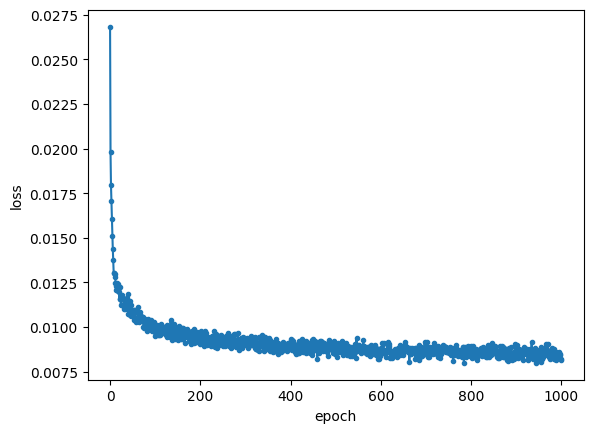

In [22]:
Real = VxmTest()
Real.CNNvxm(train_gen=train_generator, val_generator=val_generator)
Real.train(total_epo=train_no)
Real.vxm_model.save_weights(model_loc+'Real_100steps.h5')
b = Real.hist.history['loss']
a = Real.hist.history['val_loss']
df = pd.DataFrame(b)
df1= pd.DataFrame(a)
df.to_csv(csv_loc+'Real_loss_train.csv', index=False, header=False)
df1.to_csv(csv_loc+'Real_loss_val.csv', index=False, header=False)
# for i in range(no_of_rounds-1):
#     Real.vxm_model.load_weights(model_loc+'Real_100steps.h5')
#     Real.train(total_epo=train_no)
#     Real.vxm_model.save_weights(model_loc+'Real_100steps.h5')
#     b = Real.hist.history['loss']
#     df = pd.DataFrame(b)
#     df.to_csv(csv_loc+'Real_loss_100steps.csv', index=False, mode='a', header=False)

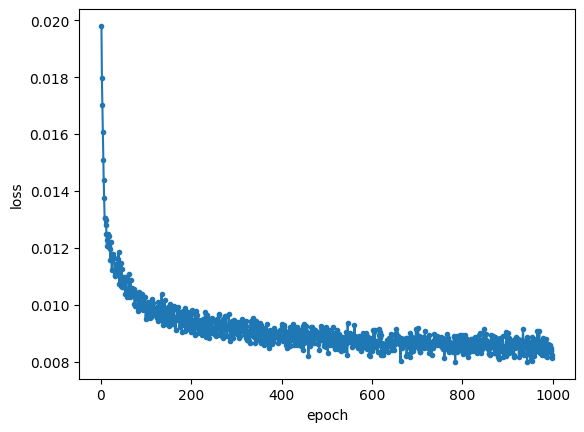

In [23]:
plot_csv(csv_loc+'Real_loss_train.csv')

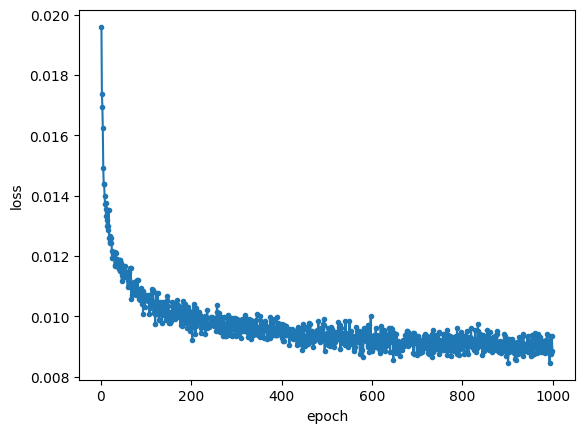

In [24]:
plot_csv(csv_loc+'Real_loss_val.csv')

In [25]:
for i in range(5, 15, 5):
    exec(f'few_shot_train_{i} = label_maps_real[:i, ...]')
# create the few shot data generator
    exec(f'few_generator_{i} = vxm_data_generator_hybrid(few_shot_train_{i}, label_maps_synth, SynthIm.label_to_image, alpha_real=alpha_real, batch_size = batch_size)')
    exec(f'train_generator_{i} = vxm_data_generator_real(few_shot_train_{i}, batch_size = batch_size)')
    exec(f'few_input_{i}, _ = next(few_generator_{i})')
    exec(f'train_input_{i}, _ = next(train_generator_{i})')

1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step


In [26]:
goblin = '.h5'
goblin_csv = '.csv'
name = 'Fshot_'
led = 'loss'
led1 = 'val_loss'
mode_csv = 'a'
name_loss = 'Fshot_loss_pure'
val_name = 'Fshot_loss_pure_val'

1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step


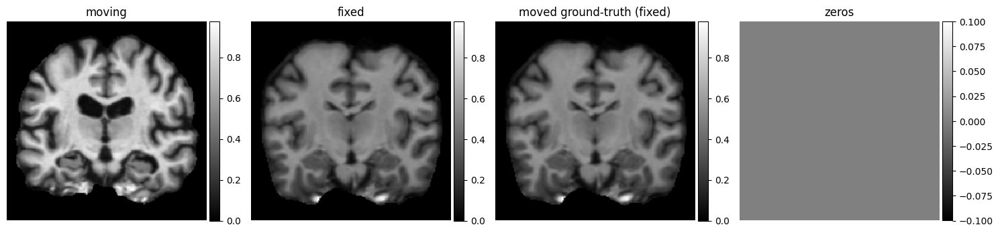

0epoch [00:00, ?epoch/s]

1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1/1000
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 2/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 3/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 4/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 5

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 5/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 6/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 7/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 8/1000
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 9/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 10/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 11/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 12/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 13/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 14/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 15/1000
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 16/1000
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 17/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 18/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 19/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 20/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 21/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 22/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 23/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 24/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 25/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 26/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 27/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 28/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 29/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 30/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 31/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 32/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 33/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 34/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 35/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 36/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 37/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 38/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 39/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 40/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 41/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 42/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 43/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 44/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 45/1000
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 46/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 47/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 48/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 49/1000
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 50/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 51/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 52/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 53/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 54/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 55/1000
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 56/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 54ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 57/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 58/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 59/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 60/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 61/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 62/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 63/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 64/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 38ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 65/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 66/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 67/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 68/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 69/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 70/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 71/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 72/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 73/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 74/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 75/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 76/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 77/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 116ms/epoch - 116ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 78/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 79/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 80/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 81/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 82/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 83/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 84/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 85/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 86/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 87/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 88/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 89/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 90/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 91/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 92/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 93/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 94/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 95/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 96/1000
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 97/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 98/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 99/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 100/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 101/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 102/1000
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 103/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 104/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 105/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 106/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 107/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 108/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 109/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 110/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 111/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 112/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 113/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 114/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 115/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 116/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 117/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 118/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 119/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 120/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 121/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 122/1000
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 123/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 124/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 125/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 126/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 127/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 128/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 129/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 130/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 131/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 132/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 133/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 134/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 135/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 136/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 137/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 138/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 139/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 140/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 141/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 142/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 143/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 144/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 38ms/epoch - 38ms/step
Epoch 145/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 146/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 76ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 147/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 148/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 149/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 150/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 116ms/epoch - 116ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 151/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 152/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 153/1000
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 154/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 155/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 156/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 157/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 158/1000
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 159/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 160/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 161/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 162/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 163/1000
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 164/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 165/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 166/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 167/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 168/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 169/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 170/1000
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 171/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 121ms/epoch - 121ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 172/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 173/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 174/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 175/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 176/1000
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 177/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 178/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 179/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 180/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 181/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 182/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 183/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 184/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 43ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 185/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 186/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 187/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 188/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 189/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 190/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 191/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 192/1000
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 193/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 194/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 195/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 196/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 197/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 198/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 199/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 200/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 201/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 202/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 53ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 203/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 204/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 205/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 206/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 207/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 3

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 208/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 209/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 210/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 211/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 212/1000
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 213/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 214/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 215/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 216/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 217/1000
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 218/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 219/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 47ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 220/1000
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 221/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 222/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 223/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 224/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 225/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 226/1000
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 227/1000
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 228/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 38ms/epoch - 38ms/step
Epoch 229/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 230/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 231/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 232/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 233/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 234/1000
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 235/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 236/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 76ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 237/1000
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 238/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 239/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 120ms/epoch - 120ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 240/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 241/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 54ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 242/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 243/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 52ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 244/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 245/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 246/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 247/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 248/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 249/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 250/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 251/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 252/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 253/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 254/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 255/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 256/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 257/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 258/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 259/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 260/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 261/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 262/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 263/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 264/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 265/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 266/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 267/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 268/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 269/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 270/1000
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 271/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 272/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 273/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 274/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 275/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 276/1000
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 277/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 278/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 279/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 280/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 281/1000
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 282/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 283/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 284/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 61ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 285/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 286/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 287/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 288/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 289/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 290/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 291/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 116ms/epoch - 116ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 77ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 292/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 293/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 294/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 295/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 296/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 297/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 298/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 299/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 300/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 301/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 302/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 303/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 304/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 305/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 306/1000
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 307/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 308/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 309/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 310/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 311/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 312/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 313/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 314/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 315/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 316/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 61ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 317/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 318/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 319/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 320/1000
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 321/1000
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 322/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 323/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 324/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 325/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 326/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 327/1000
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 328/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 329/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 34ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 330/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 32ms/epoch - 32ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 331/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 332/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 333/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 334/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 335/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 336/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 337/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 338/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 339/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 340/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 341/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 342/1000
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 343/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 344/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 345/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 346/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 347/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 348/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 349/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 350/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 351/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 352/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 353/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 354/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 355/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 356/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 357/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 358/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 359/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 360/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 361/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 362/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 363/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 364/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 365/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 41ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 366/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 367/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 368/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 369/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 370/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 371/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 372/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 373/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 374/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 375/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 376/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 377/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 378/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 379/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 380/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 381/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 382/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 383/1000
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 384/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 385/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 35ms/epoch - 35ms/step
Epoch 386/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 387/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 388/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 389/1000
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 390/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 391/1000
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 392/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 393/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 394/1000
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 395/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 396/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 397/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 398/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 399/1000
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 400/1000
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 401/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 402/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 403/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 404/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 405/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 406/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 407/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 41ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 408/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 409/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 410/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 411/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 412/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 116ms/epoch - 116ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 413/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 414/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 415/1000
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 416/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 417/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 418/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 419/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 420/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 421/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 422/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 48ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 423/1000
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 424/1000
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 425/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 426/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 427/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 428/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 429/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 430/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 431/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 432/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 433/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 434/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 435/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 436/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 437/1000
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 438/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 439/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 440/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 441/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 442/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 443/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 444/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 445/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 446/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 447/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 448/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 40ms/epoch - 40ms/step
Epoch 449/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 450/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 451/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 452/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 453/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 454/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 455/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 456/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 457/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 458/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 459/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 460/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 461/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 462/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 463/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 464/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 465/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 44ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 466/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 45ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 467/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 468/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 469/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 470/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 471/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 472/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 473/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 474/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 475/1000
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 476/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 477/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 478/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 479/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 480/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 481/1000
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 482/1000
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 483/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 484/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 53ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 485/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 486/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 487/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 488/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 489/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 490/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 491/1000
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 492/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 493/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 494/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 61ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 495/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 496/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 497/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 498/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 499/1000
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 500/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 56ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 501/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 502/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 503/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 504/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 505/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 506/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 507/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 508/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 509/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 510/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 48ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 511/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 512/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 513/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 514/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 515/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 516/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 517/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 518/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 519/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 520/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 521/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 522/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 523/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 524/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 525/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 526/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 527/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 528/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 529/1000
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 530/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 531/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 532/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 533/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 534/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 535/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 536/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 537/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 538/1000
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 539/1000
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 540/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 541/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 117ms/epoch - 117ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 542/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 543/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 544/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 545/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 546/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 547/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 548/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 63ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 549/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 550/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 551/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 552/1000
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 553/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 554/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 555/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 556/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 557/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 73ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 558/1000
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 559/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 560/1000
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 561/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 562/1000
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 563/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 564/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 565/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 566/1000
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 567/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 568/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 569/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 570/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 571/1000
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 572/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 573/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 574/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 575/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 576/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 577/1000
1/1 - 0s - 118ms/epoch - 118ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 578/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 579/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 580/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 581/1000
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 582/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 583/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 584/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 56ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 585/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 586/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 587/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 588/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 589/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 590/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 591/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 592/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 593/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 594/1000
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 595/1000
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 596/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 597/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 598/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 599/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 43ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 600/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 601/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 602/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 603/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 604/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 605/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 3

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 606/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 607/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 608/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 609/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 610/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 611/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 612/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 613/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 614/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 615/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 616/1000
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 617/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 618/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 619/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 620/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 621/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 622/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 623/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 624/1000
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 625/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 626/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 627/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 628/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 629/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 630/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 631/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 632/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 633/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 634/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 635/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 636/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 637/1000
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 638/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 639/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 640/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 641/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 642/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 643/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 644/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 645/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 646/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 647/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 648/1000
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 649/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 41ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 650/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 651/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 652/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 41ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 653/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 654/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 655/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 656/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 657/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 658/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 659/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 660/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 661/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 662/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 663/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 664/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 665/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 666/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 667/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 668/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 669/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 670/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 671/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 672/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 673/1000
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 674/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 42ms/epoch - 42ms/step
Epoch 675/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 676/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 677/1000
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 678/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 679/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 680/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 681/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 682/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 683/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 684/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 685/1000
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 686/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 687/1000
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 688/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 689/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 51ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 690/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 691/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 692/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 693/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 694/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 695/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 696/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 697/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 698/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 699/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 700/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 701/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 702/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 703/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 704/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 705/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 706/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 707/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 708/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 709/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 710/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 711/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 712/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 713/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 714/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 715/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 716/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 717/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 718/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 719/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 720/1000
1/1 - 0s - 120ms/epoch - 120ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 116ms/epoch - 116ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 721/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 722/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 723/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 724/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 725/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 726/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 727/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 728/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 729/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 730/1000
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 731/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 732/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 733/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 734/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 735/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 41ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 736/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 737/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 738/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 739/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 740/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 741/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 742/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 743/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 744/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 745/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 746/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 747/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 748/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 749/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 750/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 66ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 751/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 752/1000
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 753/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 754/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 755/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 756/1000
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 757/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 758/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 759/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 760/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 761/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 762/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 763/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 764/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 765/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 766/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 767/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 768/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 3

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 769/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 770/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 771/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 772/1000
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 773/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 42ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 774/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 775/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 776/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 777/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 778/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 779/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 780/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 781/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 782/1000
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 783/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 784/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 785/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 786/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 787/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 788/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 116ms/epoch - 116ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 45ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 789/1000
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 790/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 791/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 792/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 793/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 794/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 795/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 796/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 797/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 798/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 799/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 800/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 801/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 802/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 803/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 75ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 804/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 805/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 806/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 807/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 808/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 809/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 810/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 811/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 116ms/epoch - 116ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 43ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 812/1000
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 813/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 814/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 815/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 816/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 817/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 818/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 819/1000
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 820/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 821/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 34ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 822/1000
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 823/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 824/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 825/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 826/1000
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 827/1000
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 828/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 829/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 830/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 831/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 832/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 833/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 834/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 835/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 836/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 6

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 837/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 838/1000
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 34ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 839/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 840/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 841/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 842/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 66ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 843/1000
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 844/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 845/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 846/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 847/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 848/1000
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 849/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 850/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 851/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 35ms/epoch - 3

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 852/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 853/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 854/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 49ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 855/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 856/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 857/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 858/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 859/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 860/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 861/1000
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 862/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 863/1000
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 864/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 865/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 866/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 867/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 868/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 869/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 870/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 871/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 872/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 873/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 874/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 875/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 876/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 877/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 878/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 879/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 880/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 41ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 881/1000
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 882/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 883/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 884/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 885/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 886/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 39ms/epoch - 39ms/step
Epoch 887/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 888/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 889/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 890/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 891/1000
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 892/1000
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 893/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 894/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 895/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 896/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 897/1000
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 898/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 899/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 900/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 901/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 902/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 903/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 904/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 905/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 906/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 907/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 908/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 909/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 910/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 911/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 44ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 912/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 913/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 914/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 915/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 916/1000
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 917/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 918/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 919/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 920/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 921/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 922/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 923/1000
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 924/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 925/1000
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 926/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 927/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 928/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 929/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 930/1000
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 931/1000
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 932/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 933/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 934/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 935/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 936/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 937/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 938/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 939/1000
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 940/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 116ms/epoch - 116ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 941/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 942/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 943/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 944/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 945/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 946/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 947/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 948/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 949/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 950/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 951/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 952/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 953/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 954/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 955/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 956/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 57ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 957/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 958/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 959/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 960/1000
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 961/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 962/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 963/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 964/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 965/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 966/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 967/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 968/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 969/1000
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 970/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 971/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 972/1000
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 973/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 974/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 35ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 975/1000
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 976/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 977/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 978/1000
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 979/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 980/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 981/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 982/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 983/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 984/1000
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 985/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 986/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 987/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 988/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 989/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 42ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 990/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 991/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 74ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 992/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 993/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 50ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 994/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 995/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 996/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 997/1000
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 998/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 999/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1000/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 75ms/

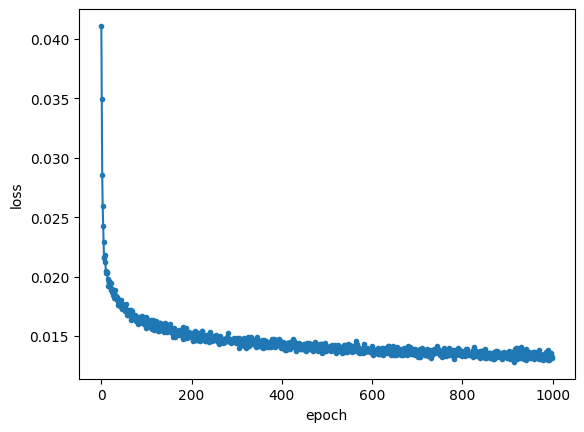

1/1 [==============================] - 0s 277ms/step


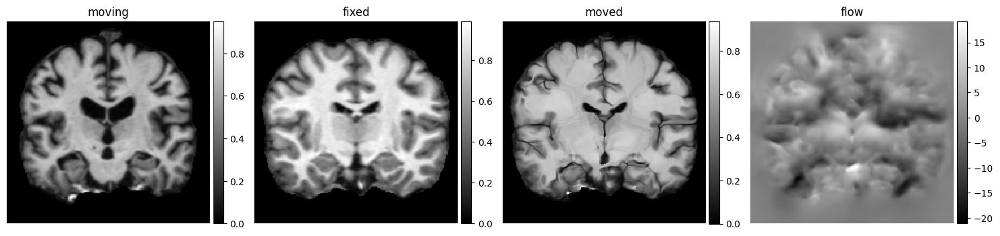

1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step


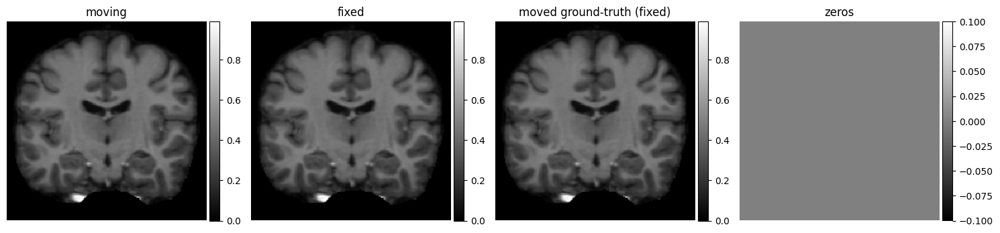

0epoch [00:00, ?epoch/s]

1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1/1000
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 2/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 3/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/st

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 4/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 6

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 5/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 6/1000
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 5

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 7/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 8/1000
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 9/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 10/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 11/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 12/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 13/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 14/1000
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 15/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 16/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 17/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 18/1000
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 19/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 20/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 21/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 22/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 23/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 24/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 49ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 25/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 26/1000
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 27/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 28/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 29/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 30/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 31/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 32/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 33/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 34/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 44ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 35/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 36/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 37/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 38/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 39/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 40/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 41/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 42/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 46ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 43/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 44/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 45/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 46/1000
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 47/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 48/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 49/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 50/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 51/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 52/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 53/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 54/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 55/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 56/1000
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 57/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 58/1000
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 59/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 45ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 60/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 61/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 62/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 63/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 64/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 65/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 66/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 67/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 72ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 68/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 69/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 70/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 71/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 72/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 73/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 74/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 50ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 75/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 76/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 77/1000
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 78/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 79/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 80/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 81/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 82/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 83/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 84/1000
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 85/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 86/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 87/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 88/1000
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 89/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 90/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 91/1000
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 92/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 93/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoc

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 94/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/ep

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 95/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 96/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 97/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 98/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 99/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch 

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 100/1000
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 101/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 102/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 103/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 104/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 105/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 106/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 107/1000
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 108/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 109/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 47ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 110/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 111/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 112/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 113/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 114/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 115/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 116/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 117/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 118/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 119/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 120/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 121/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 122/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 123/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 124/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 125/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 126/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 127/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 128/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 129/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 130/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 131/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 132/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 133/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 134/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 116ms/epoch - 116ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 42ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 135/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 136/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 137/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 138/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 46ms/epoch - 46ms/step
Epoch 139/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 140/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 141/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 142/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 143/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 144/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 145/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 74ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 146/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 147/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 148/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 149/1000
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 150/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 151/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 152/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 153/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 154/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 155/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 156/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 157/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 158/1000
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 159/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 160/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 161/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 162/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 163/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 164/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 165/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 166/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 167/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 168/1000
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 43ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 169/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 170/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 171/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 172/1000
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 173/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 174/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 175/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 176/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 177/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 178/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 179/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 180/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 181/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 182/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 183/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 184/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 185/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 186/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 187/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 188/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 189/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 190/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 191/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 192/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 193/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 194/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 195/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 196/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 197/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 198/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 199/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 200/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 201/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 202/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 203/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 35ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 204/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 205/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 206/1000
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 207/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 208/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 209/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 210/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 211/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 55ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 212/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 213/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 214/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 215/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 216/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 217/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 218/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 43ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 219/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 220/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 221/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 222/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 223/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 224/1000
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 225/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 226/1000
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 227/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 228/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 229/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 230/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 231/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 232/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 233/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 234/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 235/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 47ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 236/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 237/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 238/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 239/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 240/1000
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 241/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 242/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 243/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 244/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 245/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 246/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 247/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 248/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 249/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 250/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 251/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 252/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 253/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 254/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 255/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 256/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 257/1000
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 258/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 259/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 260/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 261/1000
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 262/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 263/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 264/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 265/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 61ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 266/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 267/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 268/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 269/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 51ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 270/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 271/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 272/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 273/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 274/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 275/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 276/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 277/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 278/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 279/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 280/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 281/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 282/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 283/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 284/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 285/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 286/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 287/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 41ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 288/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 289/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 290/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 291/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 292/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 293/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 294/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 295/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 296/1000
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 297/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 298/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 299/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 300/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 301/1000
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 302/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 303/1000
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 304/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 305/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 306/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 307/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 308/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 309/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 310/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 311/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 312/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 313/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 314/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 315/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 316/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 317/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 318/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 319/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 320/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 321/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 322/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 323/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 324/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 325/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 326/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 327/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 328/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 329/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 330/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 331/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 332/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 333/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 334/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 335/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 336/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 337/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 338/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 42ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 339/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 340/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 341/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 342/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 343/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 344/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 345/1000
1/1 - 0s - 117ms/epoch - 117ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 346/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 63ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 347/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 348/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 349/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 350/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 351/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 352/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 353/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 354/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 355/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 356/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 357/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 358/1000
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 359/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 360/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 361/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 362/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 363/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 364/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 49ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 365/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 366/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 367/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 368/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 369/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 370/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 371/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 372/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 373/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 62ms/epoch - 62ms/

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 374/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 375/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 376/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 377/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 378/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 379/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 380/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 381/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 382/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 3

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 383/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 384/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/st

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 385/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 386/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 387/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 388/1000
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 5

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 389/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 41ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 390/1000
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 391/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 392/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 5

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 393/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 3

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 394/1000
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 395/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 396/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 397/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 398/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 399/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 400/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 401/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 402/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 403/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 404/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 405/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 406/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 407/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 408/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 409/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 410/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 411/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 412/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 413/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 414/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 415/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 416/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 42ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 417/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 418/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 419/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 420/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 421/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 422/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 423/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 424/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 425/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 426/1000
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 427/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 428/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 429/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 430/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 431/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 432/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 433/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 434/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 435/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 436/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 437/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 438/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 439/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 440/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 441/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 442/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 443/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 444/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 445/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 446/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 447/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 448/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 449/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 450/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 451/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 452/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 453/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 454/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 455/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 456/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 457/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 458/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 459/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 460/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 461/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 462/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 463/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 464/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 465/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 466/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 467/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 468/1000
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 469/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 470/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 471/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 472/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 473/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 474/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 475/1000
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 476/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 477/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 478/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 479/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 480/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 481/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 3

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 482/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 483/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 484/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 485/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 486/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 487/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 488/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 489/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 490/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 491/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 492/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 493/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 3

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 494/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 41ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 495/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 496/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 497/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 498/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 499/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 500/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 501/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 502/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 503/1000
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 504/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 505/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 506/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 507/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 508/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 509/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 41ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 510/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 511/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 512/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 513/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 514/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 515/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 3

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 516/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 517/1000
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 518/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 519/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 43ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 520/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 71ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 521/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 4

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 522/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 523/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 524/1000
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 525/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 526/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 527/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 528/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 529/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 530/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 531/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 532/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 533/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 534/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 535/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 536/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 537/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 538/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 539/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 540/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 541/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 542/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 543/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 3

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 544/1000
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 545/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/st

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 546/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 547/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 548/1000
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 549/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 550/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 551/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 552/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 553/1000
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 554/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 555/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 63ms/epoch - 63ms/st

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 556/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 557/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 558/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 559/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 41ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 560/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 561/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 562/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 563/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 564/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 73ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 565/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 566/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 567/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 568/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 5

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 569/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 570/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 3

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 571/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 572/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 573/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 574/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 575/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 576/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 577/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 578/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 579/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 580/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 581/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 582/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 55ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 583/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 584/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 585/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 586/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 587/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 588/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 589/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 590/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 591/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 592/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 593/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 594/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 595/1000
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 596/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 597/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 598/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 599/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 42ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 600/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 601/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 602/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 603/1000
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 604/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 7

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 605/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 606/1000
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 607/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 608/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 53ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 609/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 610/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 611/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 612/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 613/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 614/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 615/1000
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 616/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 617/1000
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 41ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 618/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 619/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 620/1000
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 621/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 622/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 623/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 624/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 625/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 626/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 627/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 628/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 629/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 630/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 631/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 632/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 633/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 634/1000
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 635/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 636/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 637/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 638/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 639/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 640/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 641/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 642/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 643/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 644/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 645/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 646/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 647/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 35ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 648/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 649/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 650/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 651/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 652/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 653/1000
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 654/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 655/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 656/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 657/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 117ms/epoch - 117ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 658/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 659/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 660/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 661/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 662/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 663/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 34ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 664/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 665/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 666/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 667/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 668/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 669/1000
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 670/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 671/1000
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 672/1000
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 673/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 674/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 675/1000
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 676/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 677/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 678/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 679/1000
1/1 - 0s - 117ms/epoch - 117ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 43ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 680/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 681/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 682/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 683/1000
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 684/1000
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 685/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 686/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 687/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 688/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 50ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 689/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 690/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 691/1000
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 692/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 693/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 694/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 695/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 696/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 697/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 698/1000
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 54ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 699/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 700/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 701/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 702/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 6

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 703/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 704/1000
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 3

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 705/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 706/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 707/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 708/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 709/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 710/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 711/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 712/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 3

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 713/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 714/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 715/1000
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 716/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 717/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 718/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 719/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 720/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 721/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 722/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 723/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 34ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 724/1000
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 725/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 726/1000
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 727/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 728/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 729/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 119ms/epoch - 119ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 730/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 731/1000
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 732/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 733/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 734/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 34ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 735/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 62ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 736/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 75ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 737/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 738/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 739/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 740/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 741/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 742/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 743/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 744/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 745/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 746/1000
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 747/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 748/1000
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 749/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 750/1000
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 751/1000
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 752/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 4

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 753/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 754/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 755/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 756/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 757/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 758/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 759/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 760/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 51ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 761/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 762/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 763/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 764/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 765/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 766/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 767/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 768/1000
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 769/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 770/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 771/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 772/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 773/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 774/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 775/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 776/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 40ms/epoch - 40ms/step
Epoch 777/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 778/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 779/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 780/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 781/1000
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 782/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 783/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 784/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 785/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 786/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 787/1000
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 788/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 789/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 790/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 791/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 792/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 793/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 794/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 795/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 796/1000
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 797/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 76ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 798/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 799/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 800/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 801/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 802/1000
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 803/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 804/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 805/1000
1/1 - 0s - 116ms/epoch - 116ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 806/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 34ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 807/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 808/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 809/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 810/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 811/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 812/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 813/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 814/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 815/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 816/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 817/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 818/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 819/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 820/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 821/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 822/1000
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 823/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 824/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 825/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 826/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 827/1000
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 828/1000
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 829/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 830/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 831/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 832/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 833/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 53ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 834/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 835/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 836/1000
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 837/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 74ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 838/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 839/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 840/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 75ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 841/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 842/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 40ms/epoch - 40ms/step
Epoch 843/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 844/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 845/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 846/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 847/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 848/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 849/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 850/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 116ms/epoch - 116ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 118ms/epoch - 118ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 851/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 852/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 853/1000
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 854/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 855/1000
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 856/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 857/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 858/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 859/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 860/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 861/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 862/1000
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 863/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 864/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 865/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 866/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 867/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 868/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 869/1000
1/1 - 0s - 116ms/epoch - 116ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 870/1000
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 871/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 872/1000
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 873/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 874/1000
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 875/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 876/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 877/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 878/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 879/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 880/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 35ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 881/1000
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 882/1000
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 883/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 884/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 885/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 886/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 887/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 888/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 889/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 890/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 891/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 892/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 893/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 894/1000
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 895/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 896/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 897/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 53ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 898/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 899/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 6

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 900/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 901/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 902/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 903/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 40ms/epoch - 40ms/step
Epoch 904/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 905/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 906/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 907/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 41ms/epoch - 41ms/step
Epoch 908/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 909/1000
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 910/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 911/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 912/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 913/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 914/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 915/1000
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 916/1000
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 917/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 918/1000
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 919/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 920/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 921/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 922/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 923/1000
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 924/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 925/1000
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 926/1000
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 927/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 928/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 929/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 930/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 931/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 932/1000
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 40ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 933/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 934/1000
1/1 - 0s - 80ms/epoch - 80ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 935/1000
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 936/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 937/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 938/1000
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 939/1000
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 940/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 941/1000
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 74ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 942/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 943/1000
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 944/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 95ms/epoch - 95ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 945/1000
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 946/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 947/1000
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 62ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 948/1000
1/1 - 0s - 82ms/epoch - 82ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 949/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 33ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 950/1000
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 72ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 951/1000
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 952/1000
1/1 - 0s - 77ms/epoch - 77ms/step
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 953/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 954/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 955/1000
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 956/1000
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 72ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 957/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 958/1000
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 70ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 959/1000
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 44ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 960/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 961/1000
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 962/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 963/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 964/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 965/1000
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 35ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 966/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 87ms/epoch - 87ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 33ms/epoch - 33ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 967/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 968/1000
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 969/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 970/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 49ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 971/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 97ms/epoch - 97ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 972/1000
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 83ms/epoch - 83ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 973/1000
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 98ms/epoch - 98ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 974/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 35ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 975/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 93ms/epoch - 93ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 976/1000
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 977/1000
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 48ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 978/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 99ms/epoch - 99ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 49ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 979/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 980/1000
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 981/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 96ms/epoch - 96ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 36ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 982/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 983/1000
1/1 - 0s - 84ms/epoch - 84ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 68ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 984/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 985/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 37ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 986/1000
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 74ms/epoch - 74ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 987/1000
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 86ms/epoch - 86ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 45ms/epoch - 45ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 43ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 988/1000
1/1 - 0s - 79ms/epoch - 79ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 989/1000
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 92ms/epoch - 92ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 37ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 990/1000
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 991/1000
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 73ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 992/1000
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 33ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 993/1000
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 75ms/epoch - 75ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 49ms/epoch - 49ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 39ms/epoch

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 994/1000
1/1 - 0s - 90ms/epoch - 90ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 47ms/epoch - 47ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 55ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 995/1000
1/1 - 0s - 64ms/epoch - 64ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 111ms/epoch - 111ms/step
1/1 - 0s - 94ms/epoch - 94ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 108ms/epoch - 108ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 89ms/epoch - 89ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 65ms/epoch - 65ms/step
1/1 - 0s - 38ms/epoch -

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 996/1000
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 112ms/epoch - 112ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 107ms/epoch - 107ms/step
1/1 - 0s - 78ms/epoch - 78ms/step
1/1 - 0s - 61ms/epoch - 61ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 48ms/epoch - 48ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 44ms/epoch - 44ms/step
1/1 - 0s - 76ms/epoch - 76ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 42ms/epoch - 42ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 41ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 997/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 59ms/epoch - 59ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 71ms/epoch - 71ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 50ms/epoch - 50ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epo

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 998/1000
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 91ms/epoch - 91ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 55ms/epoch - 55ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 72ms/epoch - 72ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 60ms/epoch - 60ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 66ms/epoch - 66ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 71ms/e

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 999/1000
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 88ms/epoch - 88ms/step
1/1 - 0s - 100ms/epoch - 100ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 104ms/epoch - 104ms/step
1/1 - 0s - 102ms/epoch - 102ms/step
1/1 - 0s - 52ms/epoch - 52ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 51ms/epoch - 51ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 53ms/epoch - 53ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 40ms/epoch - 40ms/step
1/1 - 0s - 41ms/epoch - 41ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 46ms/epoch - 46ms/step
1/1 - 0s - 34ms/epoch - 34ms/step
1/1 - 0s - 48ms/epoch - 4

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1000/1000
1/1 - 0s - 81ms/epoch - 81ms/step
1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 73ms/epoch - 73ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 57ms/epoch - 57ms/step
1/1 - 0s - 85ms/epoch - 85ms/step
1/1 - 0s - 105ms/epoch - 105ms/step
1/1 - 0s - 106ms/epoch - 106ms/step
1/1 - 0s - 103ms/epoch - 103ms/step
1/1 - 0s - 101ms/epoch - 101ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 43ms/epoch - 43ms/step
1/1 - 0s - 35ms/epoch - 35ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 62ms/epoch - 62ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 63ms/epoch - 63ms/step
1/1 - 0s - 38ms/epoch - 38ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 67ms/epoch - 67ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 70ms/epoch - 70ms/step
1/1 - 0s - 36ms/epoch - 36ms/step
1/1 - 0s - 39ms/epoch - 39ms/step
1/1 - 0s - 37ms/epoch - 37ms/step
1/1 - 0s - 69ms/epoch - 69ms/step
1/1 - 0s - 37ms/epoch 

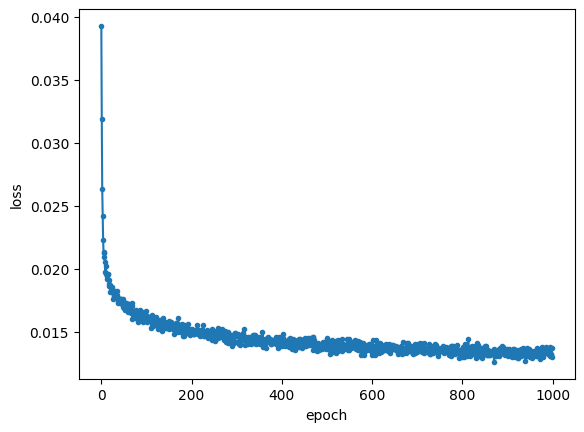

1/1 [==============================] - 0s 291ms/step


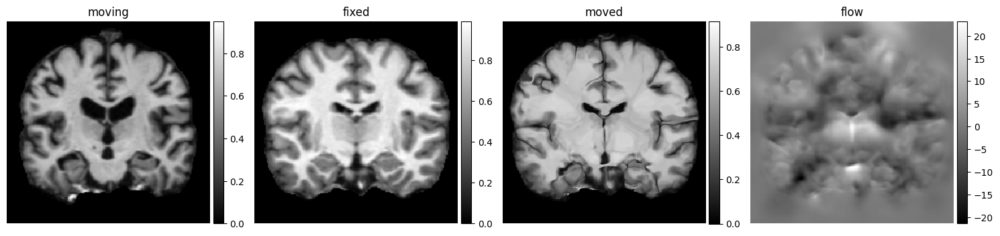

In [27]:
#Few shots training
for k in range(5, 15, 5):
    exec(f'Fshot_{k} = VxmTest()')
    exec(f'Fshot_{k}.CNNvxm(train_gen=few_generator_{k}, val_generator=val_generator)')
    exec(f'Fshot_{k}.train(total_epo = train_no)')
    exec(f'loc = model_loc+name+str({k})+goblin')
    exec(f'Fshot_{k}.vxm_model.save_weights(model_loc+name+str({k})+goblin)')
    exec(f'b = Fshot_{k}.hist.history[led]')
    exec(f'a = Fshot_{k}.hist.history[led1]')
    exec(f'df = pd.DataFrame(b)')
    exec(f'df1 = pd.DataFrame(a)')
    exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
    exec(f'loc1 = csv_loc+val_name+str({k})+goblin_csv')
    exec(f'df.to_csv(loc, index=False, header=False)')
    exec(f'df1.to_csv(loc1, index=False, header=False)')
#     # for i in range(no_of_rounds-1):
#     #     exec(f'Fshot_{k}.vxm_model.load_weights(model_loc+name+str({k})+goblin)')
#     #     exec(f'Fshot_{k}.train(total_epo = train_no)')
#     #     exec(f'Fshot_{k}.vxm_model.save_weights(model_loc+name+str({k})+goblin)')
#     #     exec(f'b = Fshot_{k}.hist.history[led]')
#     #     exec(f'df = pd.DataFrame(b)')
#     #     exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
#     #     exec(f'df.to_csv(loc, mode = mode_csv, index=False, header=False)')

    exec(f'fshot_{k} = Fshot_{k}.RegPred(val_input)[1]')

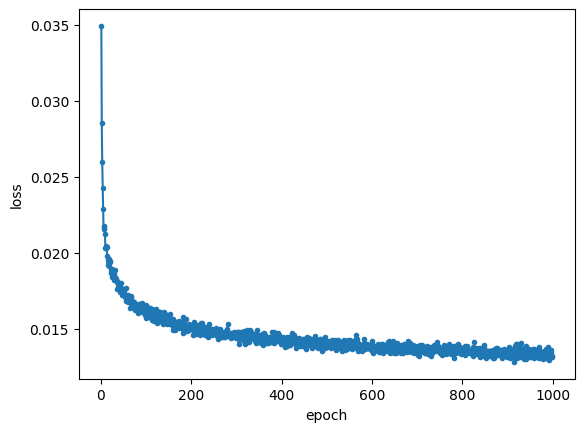

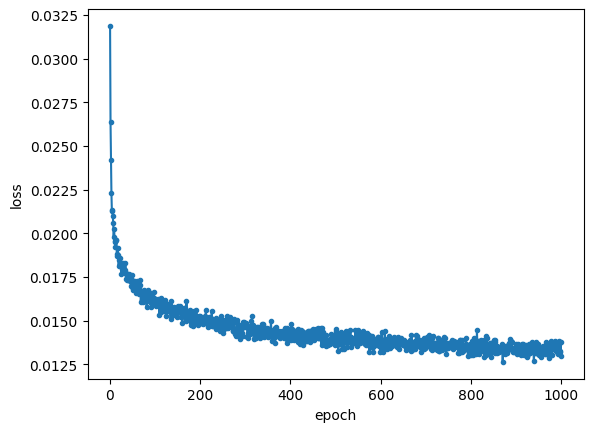

In [28]:
for k in range(5, 15, 5):
    exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
    exec(f'plot_csv(loc)')

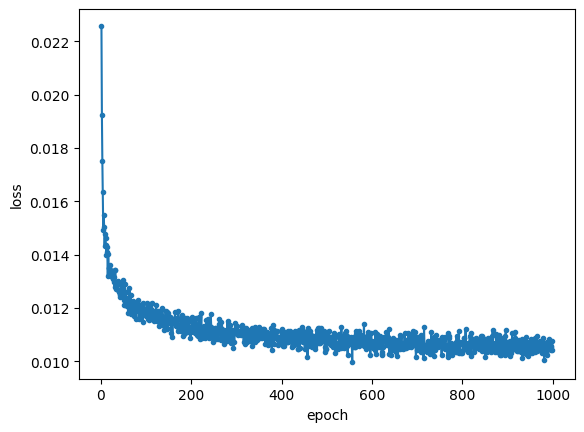

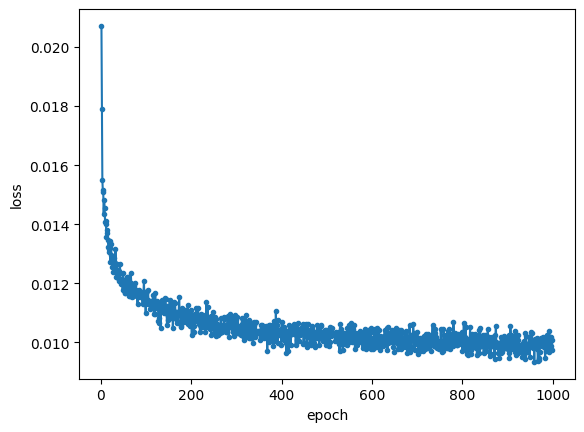

In [29]:
for k in range(5, 15, 5):
    exec(f'loc = csv_loc+val_name+str({k})+goblin_csv')
    exec(f'plot_csv(loc)')

In [30]:
# goblin = '.h5'
# goblin_csv = '.csv'
# name = 'Real_Fshot_'
# mode_csv = 'a'
# name_loss = 'Fshot_loss_pure'

In [31]:
# #Few shots training
# for k in range(5, 15, 5):
#     exec(f'Hybrid_fshot_{k} = VxmTest()')
#     exec(f'Hybrid_fshot_{k}.CNNvxm(train_gen=few_generator_{k}, val_generator=val_generator)')
#     exec(f'Hybrid_fshot_{k}.train(total_epo = train_no)')
#     exec(f'loc = model_loc+name+str({k})+goblin')
#     exec(f'Hybrid_fshot_{k}.vxm_model.save_weights(model_loc+name+str({k})+goblin)')
#     exec(f'b = Hybrid_fshot_{k}.hist.history[led]')
#     exec(f'df = pd.DataFrame(b)')
#     exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
#     exec(f'df.to_csv(loc, index=False, header=False)')
#     # for i in range(no_of_rounds-1):
#     #     exec(f'Hybrid_fshot_{k}.vxm_model.load_weights(model_loc+name+str({k})+goblin)')
#     #     exec(f'Hybrid_fshot_{k}.train(total_epo = train_no)')
#     #     exec(f'Hybrid_fshot_{k}.vxm_model.save_weights(model_loc+name+str({k})+goblin)')
#     #     exec(f'b = Hybrid_fshot_{k}.hist.history[led]')
#     #     exec(f'df = pd.DataFrame(b)')
#     #     exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
#     #     exec(f'df.to_csv(loc, mode = mode_csv, index=False, header=False)')

#     exec(f'Hybrid_fshot_{k} = Hybrid_fshot_{k}.RegPred(val_input)[1]')

In [32]:
# for k in range(5, 15, 5):
#     exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
#     exec(f'plot_csv(loc)')

In [33]:
# goblin = '.h5'
# goblin_csv = '.csv'
# name = 'Hybr_'
# mode_csv = 'a'
# name_loss = 'Hybr_Loss_'
# val_loss = 'Hybr_loss_val_'

In [34]:
# for k in range(0, 100, 5):
#     exec(f'Hybr_{k} = VxmTest()')
#     exec(f'hybrid_generator_{k} = vxm_data_generator_hybrid(real_train, label_maps_synth, SynthIm.label_to_image, alpha_real=k/100, batch_size=batch_size)')
#     exec(f'Hybr_{k}.CNNvxm(train_gen=hybrid_generator_{k}, val_generator=val_generator)')
#     exec(f'Hybr_{k}.train(total_epo = train_no)')
#     exec(f'Hybr_{k}.vxm_model.save_weights(model_loc+name+str({k})+goblin)')
#     led = 'loss'
#     led1 = 'val_loss' 
#     exec(f'b = Hybr_{k}.hist.history[led]')
#     exec(f'a = Hybr_{k}.hist.history[led1]')
#     exec(f'df = pd.DataFrame(b)')
#     exec(f'df1 = pd.DataFrame(a)')
#     exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
#     exec(f'loc1 = csv_loc+val_loss+str({k})+goblin_csv')
#     exec(f'df.to_csv(loc, index=False, header=False)')
#     exec(f'df1.to_csv(loc1, index=False, header=False)')

#     # for i in range(no_of_rounds-1):
#     #     exec(f'Hybr_{k}.vxm_model.load_weights(model_loc+name+str({k})+goblin)')
#     #     exec(f'Hybr_{k}.train(total_epo = train_no)')
#     #     exec(f'Hybr_{k}.vxm_model.save_weights(model_loc+name+str({k})+goblin)')
#     #     led = 'loss'
#     #     exec(f'b = Hybr_{k}.hist.history[led]')
#     #     exec(f'df = pd.DataFrame(b)')
#     #     exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
#     #     exec(f'df.to_csv(loc, mode = mode_csv, index=False, header=False)')
#     exec(f'hybr_{k} = Hybr_{k}.RegPred(val_input)[1]')

In [35]:
# for k in range(0, 100, 5):
#     exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
#     exec(f'plot_csv(loc)')

In [36]:
# for k in range(0, 100, 5):
#     exec(f'loc = csv_loc+val_loss+str({k})+goblin_csv')
#     exec(f'plot_csv(loc)')

1/1 [==============================] - 0s 266ms/step


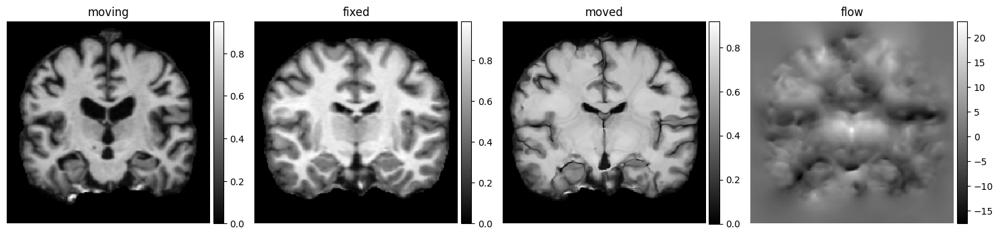

1/1 [==============================] - 0s 266ms/step


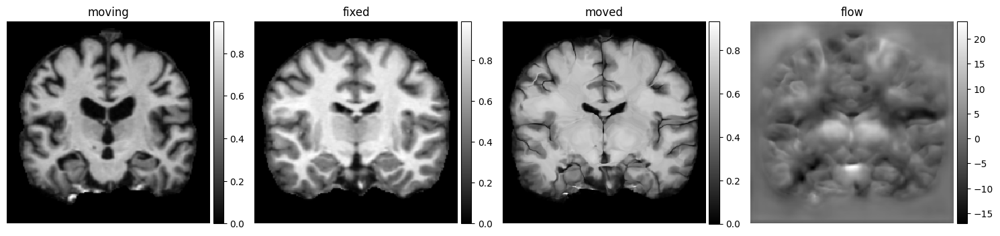

In [37]:
real = Real.RegPred(val_input)[1]
synth = Synth.RegPred(val_input)[1]

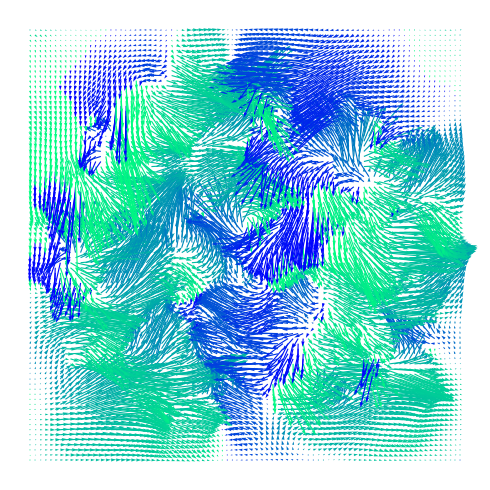

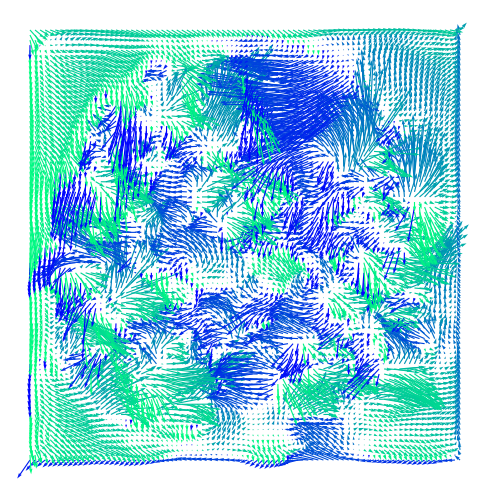

In [38]:
ne.plot.flow([real[1].squeeze()[::3,::3]], width=5);
ne.plot.flow([synth[1].squeeze()[::3,::3]], width=5);

In [39]:
# for k in range(0, 100, 5):
#     exec(f'ne.plot.flow([hybr_{k}[1].squeeze()],titles=k, width=5);')

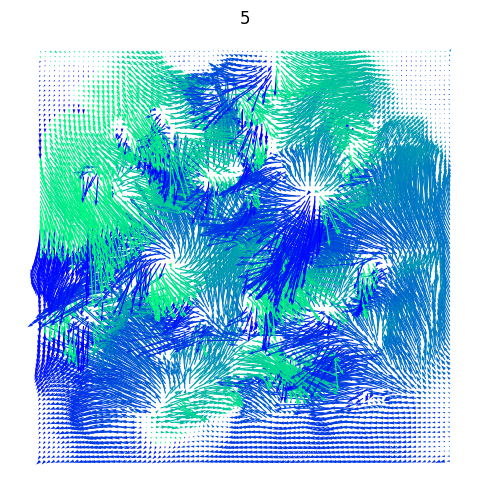

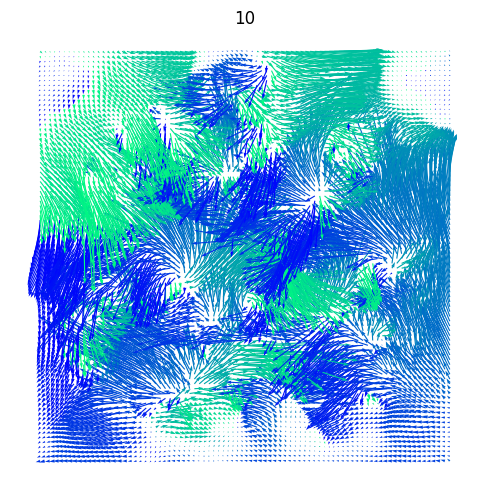

In [40]:
for k in range(5, 15, 5):
    exec(f'ne.plot.flow([fshot_{k}[0].squeeze()[::3, ::3]],titles=k, width=5);')

In [41]:
# for k in range(5, 15, 5):
#     exec(f'ne.plot.flow([Hybrid_fshot_{k}[0].squeeze()[::3, ::3]],titles=k, width=5);')